<a href="https://colab.research.google.com/github/butlerbt/SegmentingBuildings/blob/colab/tier1_batch_processing_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#mount drive
from google.colab import drive 
drive.mount('/content/drive/', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


In [2]:
#enable Google Drive to be used to host .py modules
!pip install pydrive                             # Package to use Google Drive API - not installed in Colab VM by default
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth                    # Other necessary packages
from oauth2client.client import GoogleCredentials
auth.authenticate_user()                         # Follow prompt in the authorization process


In [3]:
#make gdal adjustments for solaris installation 
!add-apt-repository ppa:ubuntugis/ubuntugis-unstable -y
!apt-get update
!apt-get install python-numpy gdal-bin libgdal-dev python3-rtree
!apt install python3-rtree

#intall libraires to colab runtime 
!pip install solaris
!pip install rasterio
!pip install geopandas
!pip install descartes
!pip install solaris
!pip install rio-tiler

Ign:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:2 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran35/ InRelease [3,626 B]
Get:3 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease [21.3 kB]
Ign:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release
Hit:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Hit:7 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:8 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:9 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Get:10 http://ppa.launchpad.net/marutter/c2d4u3.5/ubuntu bionic InRelease [15.4 kB]
Get:11 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Get:12 http://ppa.launchpad.net/ubuntugis/ubuntugis-unstable/ubuntu bioni

     |████████████████████████████████| 112kB 2.8MB/s 
  Created wheel for rio-tiler: filename=rio_tiler-1.3.1-cp36-none-any.whl size=172294 sha256=68bb5d28049a95c3eed9f38333ebc03abbf62490c58f90ec357f746f95f67933
  Stored in directory: /root/.cache/pip/wheels/13/0f/f0/2e7e21b2aeaa99791322cdd28262bbf3da097d24a4bf640f47
  Created wheel for rio-toa: filename=rio_toa-0.3.0-cp36-none-any.whl size=12428 sha256=eefc971f3f3ba0135759bee4e73c078e19f3abb9389d3804e1baf07fbb47a5b1
  Stored in directory: /root/.cache/pip/wheels/12/25/52/036fe06fa14768bf5e4eef4abd4beccb3924b695199f1721a2
Successfully built rio-tiler rio-toa


In [8]:
#pretty much always have to install solaris twice to get it without an error
! pip install torchvision==0.4.2
!pip install solaris


In [0]:
#import .py files from drive as modules to access pipeline functions
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
proc_module = drive.CreateFile({"id": "1NscGZFV0KstZ-JsEZ430NdCBWR8nADpt"})   # "your_module_file_id" is the part after "id=" in the shareable link
proc_module.GetContentFile("processing_colab.py") # Save the .py module file to Colab VM
vis_module = drive.CreateFile({"id":"1fR6zXs-_EpjWxP6x_Mff42bMWC_ZB_50"})   
vis_module.GetContentFile("visualization.py")  
import visualization as vis         
import processing_colab as proc    # Ready to import. Don't include".py" part, of course :)

In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed/
!rm -rf drive/My\ Drive/seg_building_foots/data/processed/*

In [12]:
#download the full set of train_tier_1 data
!wget https://drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com/train_tier_1.tgz
!tar -xvzf train_tier_1.tgz 
!rm train_tier_1.tgz

--2020-02-05 18:57:32--  https://drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com/train_tier_1.tgz
Resolving drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com (drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com)... 52.219.72.17
Connecting to drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com (drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com)|52.219.72.17|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 32379673093 (30G) [application/x-tar]
Saving to: ‘train_tier_1.tgz’

train_tier_1.tgz    100%[===================>]  30.16G  29.7MB/s    in 17m 28s 

2020-02-05 19:15:00 (29.5 MB/s) - ‘train_tier_1.tgz’ saved [32379673093/32379673093]

train_tier_1/
train_tier_1/znz/
train_tier_1/znz/bc32f1-labels/
train_tier_1/znz/bc32f1-labels/bc32f1-labels.json
train_tier_1/znz/bc32f1-labels/bc32f1.geojson
train_tier_1/znz/9b8638-labels/
train_tier_1/znz/9b8638-labels/9b8638-labels.json
train_tier_1/znz/9b8638-labels/9b8638.geojson
train

In [13]:
#Get file paths for batch processing. only run this cell if the burn_tiles_colab function has yet to be run, 
#otherwise the demension issue will arise
zoom_level = 19
tif_file_df, label_file_df = proc.file_path_df_colab(1) 


Found  31 images
Found 31 labels


### Create 4694 tiles at zoom = 19, image size = 256x256




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 kam
 4e7c7f
 iteration 0
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


239it [00:35, 10.45it/s]
239it [02:24,  1.66it/s]


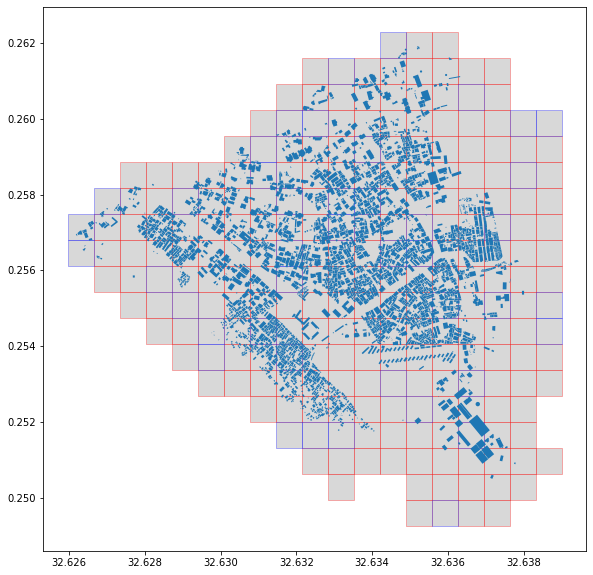

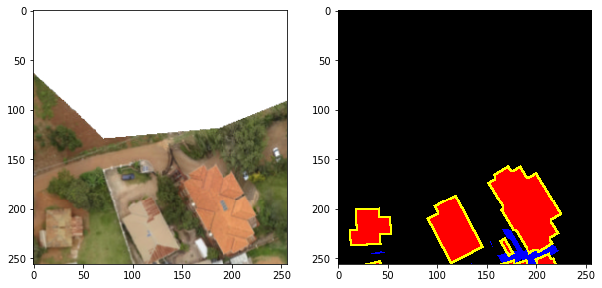

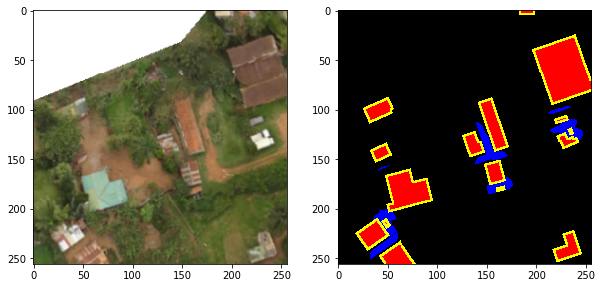

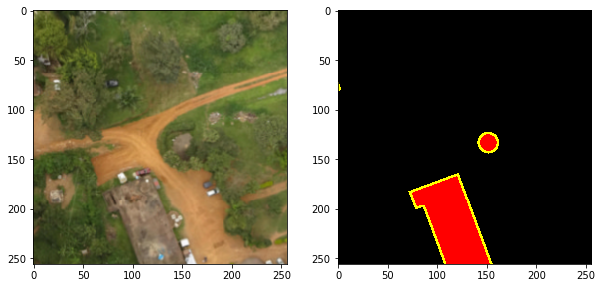

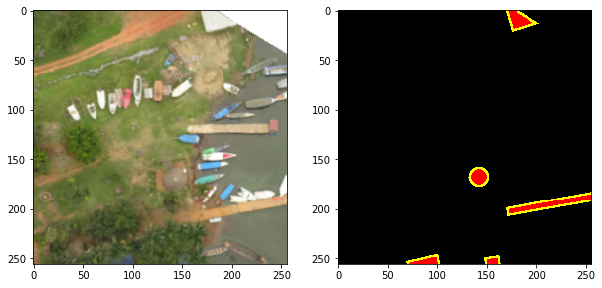

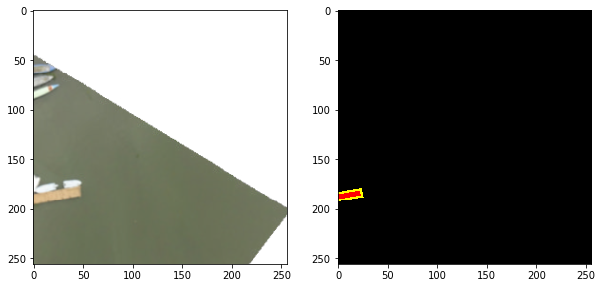




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 42f235
 iteration 1
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


2296it [06:27,  8.14it/s]
2296it [31:02,  1.75it/s]


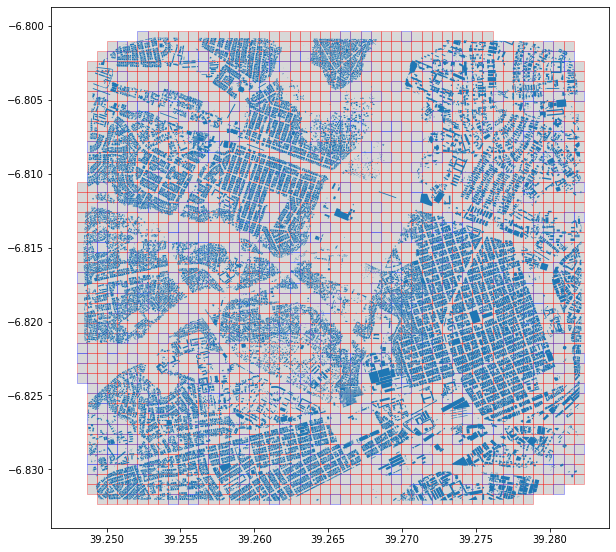

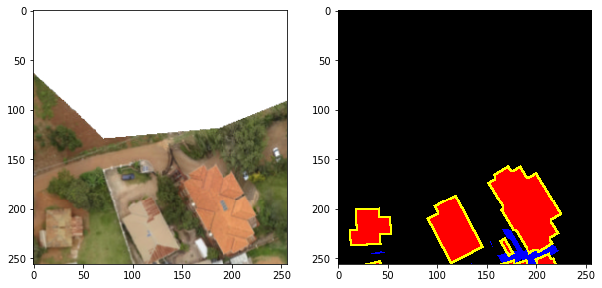

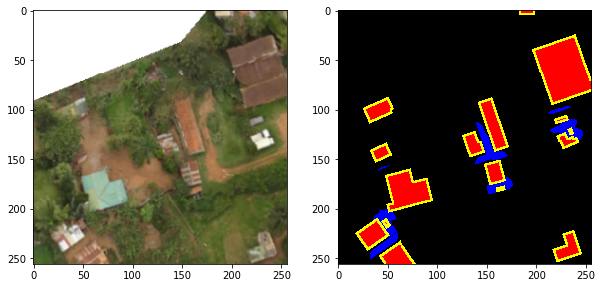

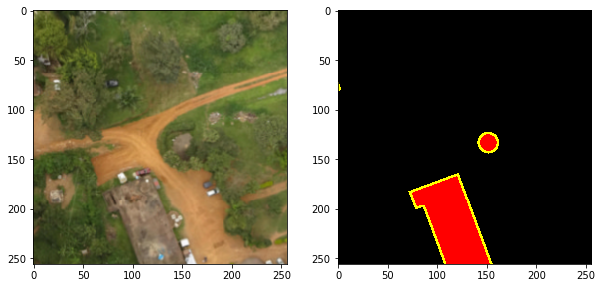

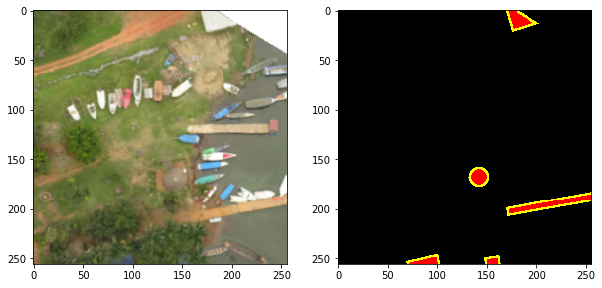

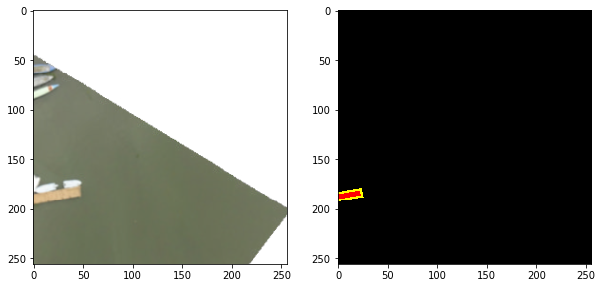




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 f883a0
 iteration 2
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


2078it [05:17,  9.17it/s]
2078it [28:42,  1.93it/s]


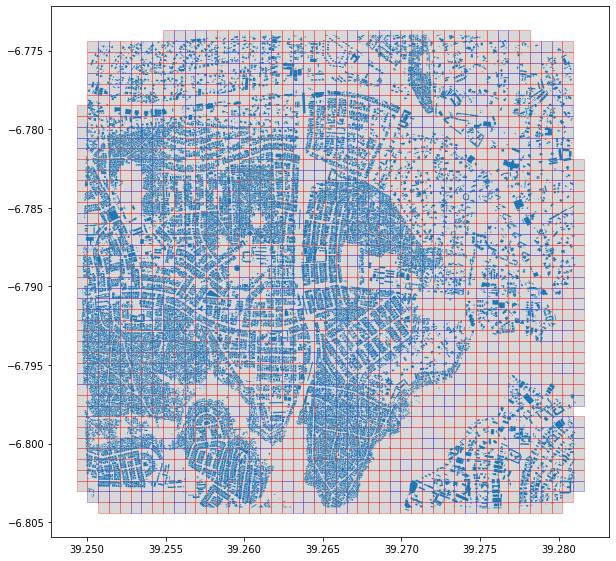

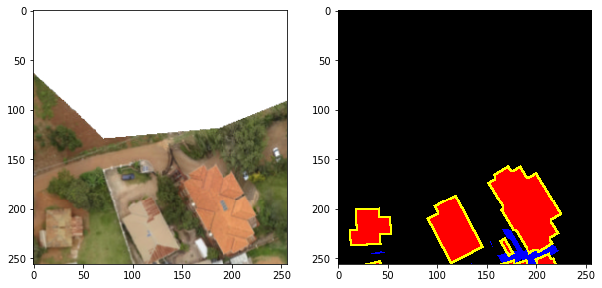

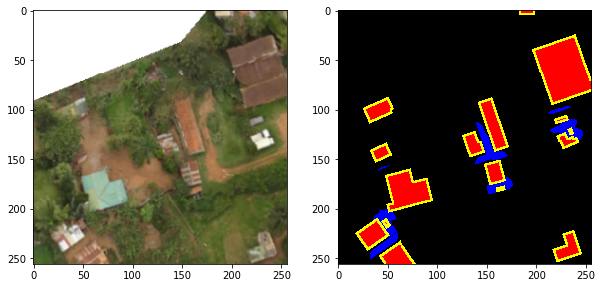

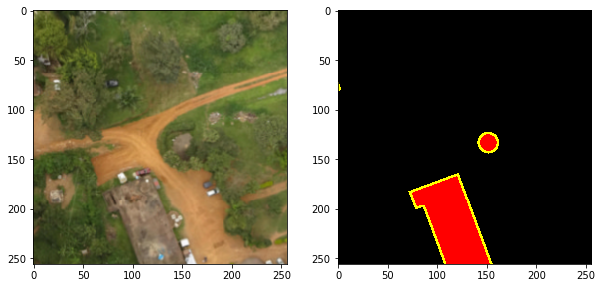

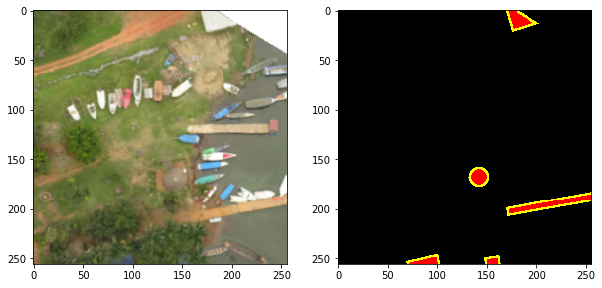

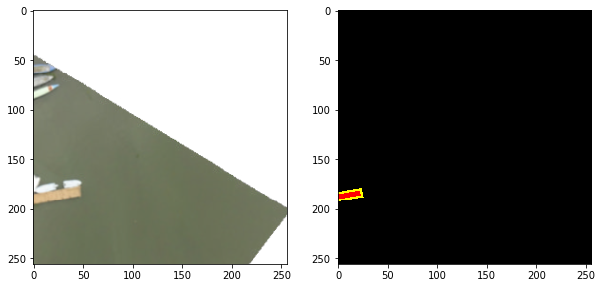




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 0a4c40
 iteration 3
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


1657it [06:05,  4.54it/s]
1657it [09:46,  2.82it/s]


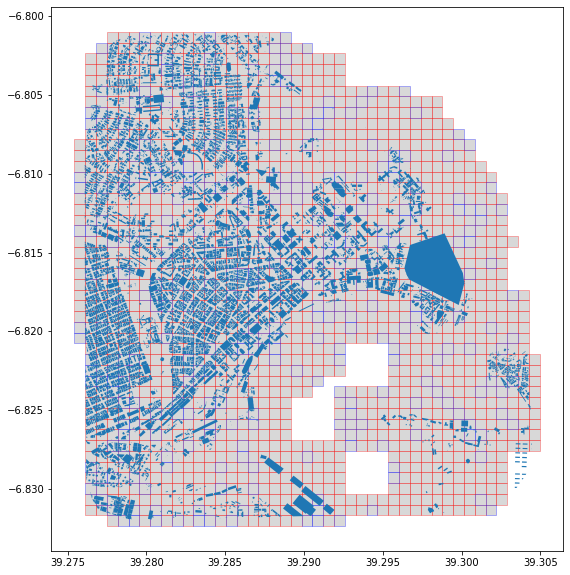

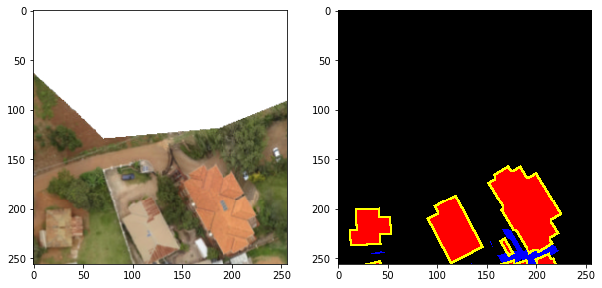

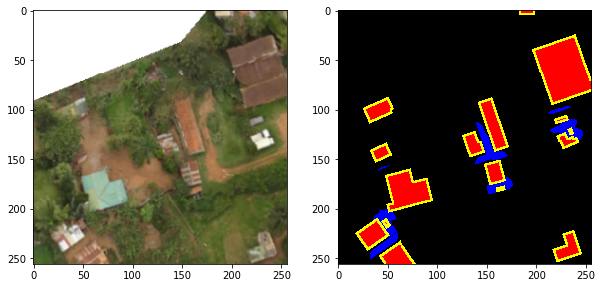

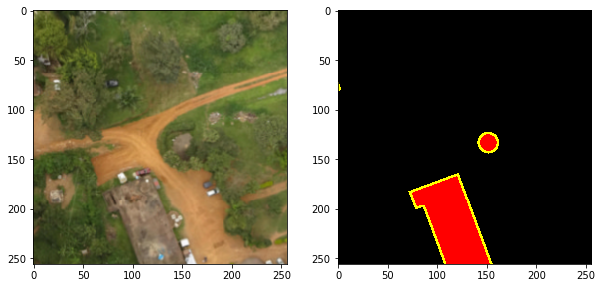

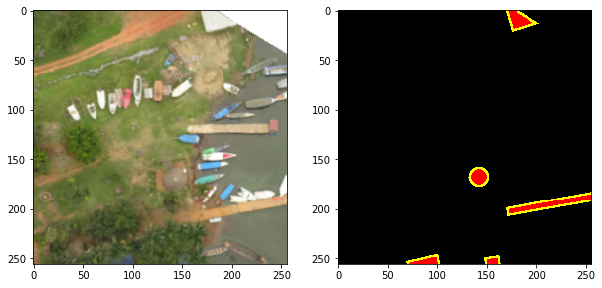

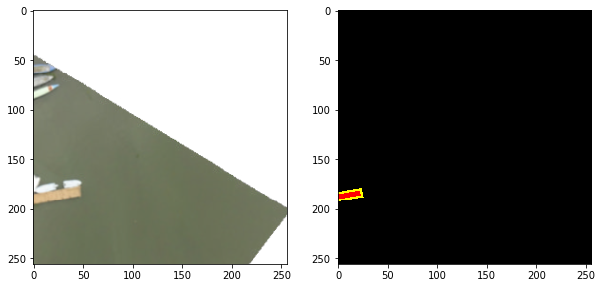




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 b15fce
 iteration 4
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


720it [01:31,  9.06it/s]
720it [13:59,  1.61it/s]


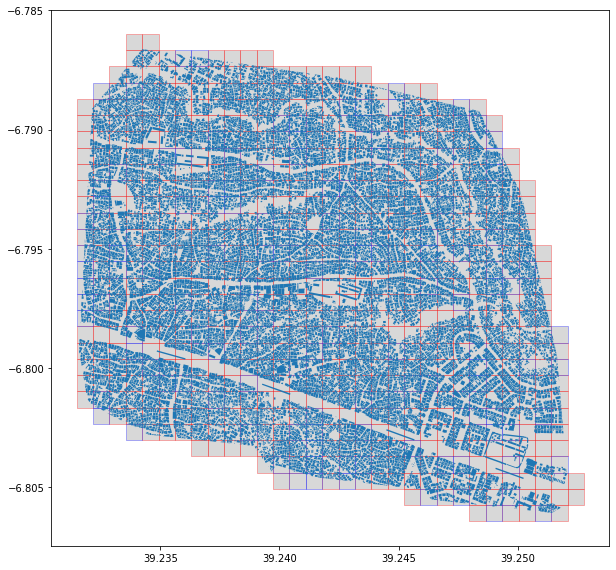

KeyboardInterrupt: ignored

In [23]:
for i in range(len(tif_file_df['tif_file_path'])):
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, visualize=False)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=False)
  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=256, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= 256, region= region,
                          zone= zone, save_path= mask_path_clean, channels=3, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(5,10, df_filepaths)

### Create 4 zones of zoom = 17, image size = 1028x1028

In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed_1band_256
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_256




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 665946
 iteration 20
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


42it [00:54,  1.11it/s]
42it [00:07,  6.63it/s]


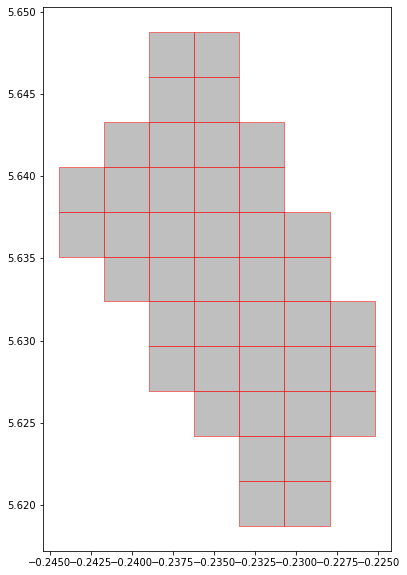

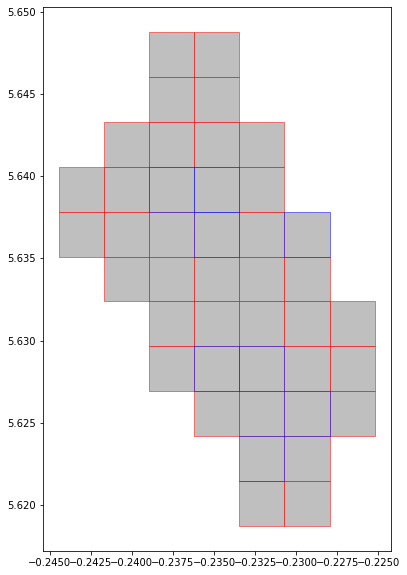

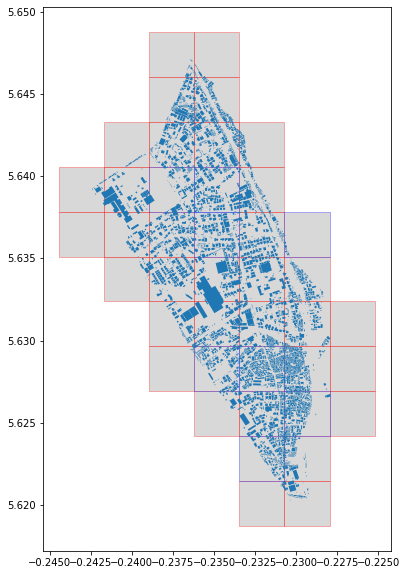

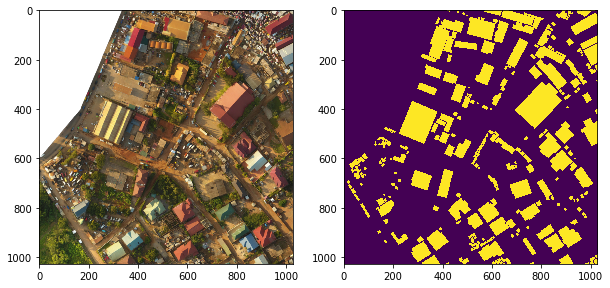

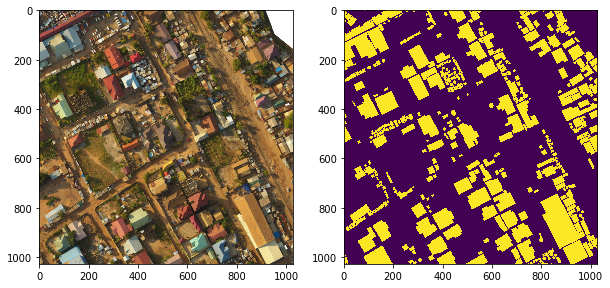

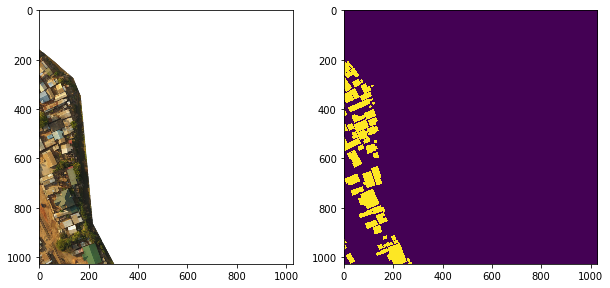

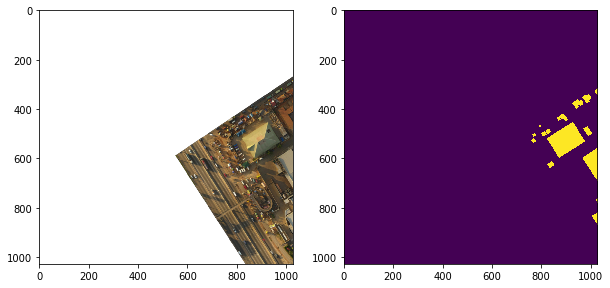

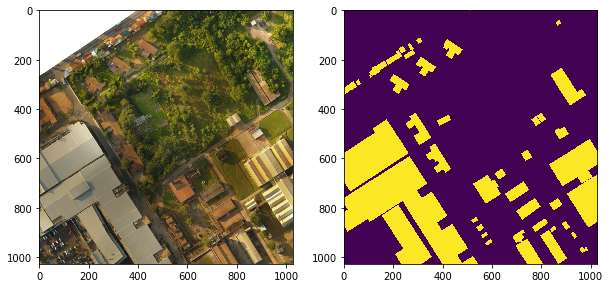

In [46]:
i = 20
zoom_level = 17
image_size = 1028
label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, zoom_level=zoom_level, visualize=True)
tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=True)

# Visualize the tiles over the polygons
vis.visualize_burned_cells(tiles_gdf, label_gdf)
tiles_gdf = proc.reformat_xyz(tiles_gdf)

# get the geometries from the geodataframe
all_polys_series = label_gdf.geometry
# preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

#img_path_clean = proc.transform_paths_for_skimage(img_path)
img_path_clean = img_path.replace('\\','')
proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=1028, zone=zone, 
                        region= region, save_path= img_path_clean)

# mask_path_clean = proc.transform_paths_for_skimage(mask_path)
mask_path_clean = mask_path.replace('\\','')
proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= 1028, region= region,
                        zone= zone, save_path= mask_path_clean, channels=1, display=False)
df_filepaths = proc.make_filepath_df(img_path_clean)
df_filepaths.head()
vis.visualize_saved_tiles(5,10, df_filepaths)

In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed_1band_1028_17
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_1028_17




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 06f252
 iteration 10
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


121it [02:48,  3.35it/s]
121it [00:04, 27.20it/s]


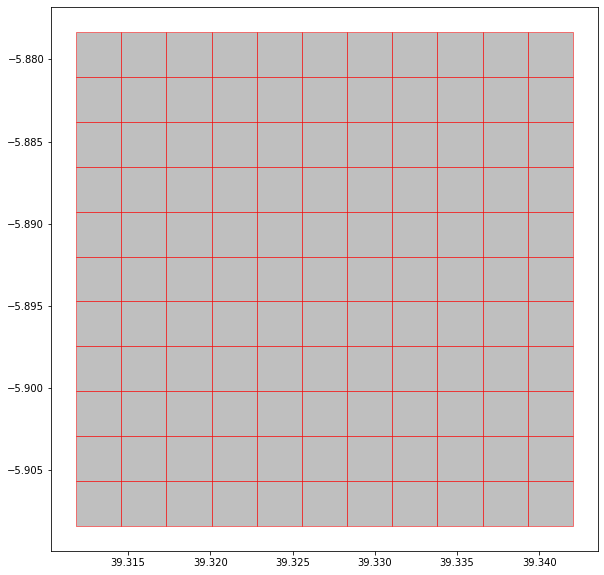

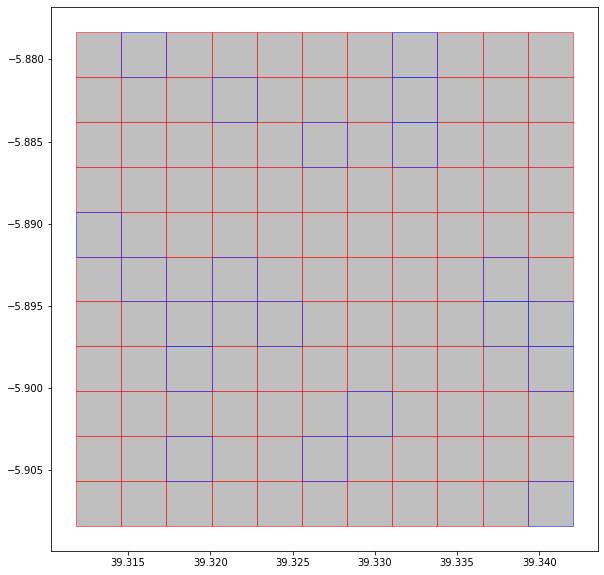

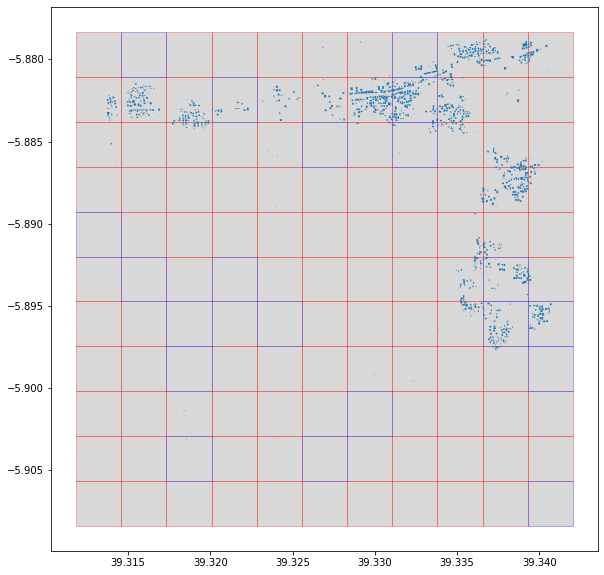

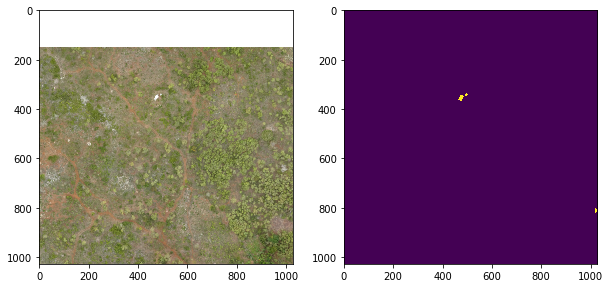

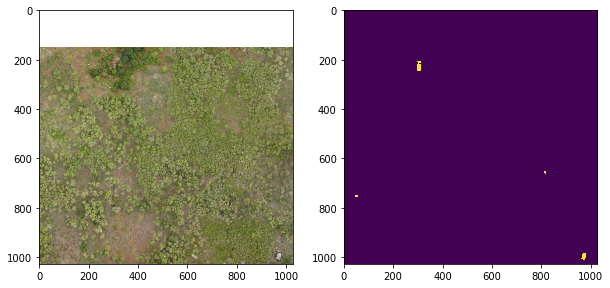

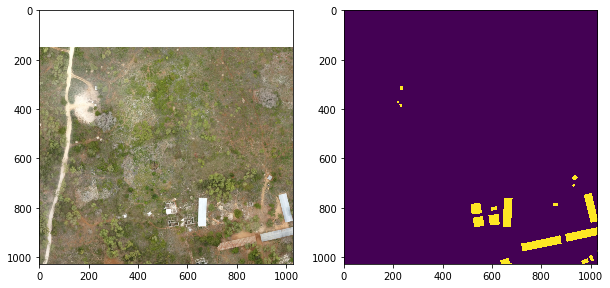

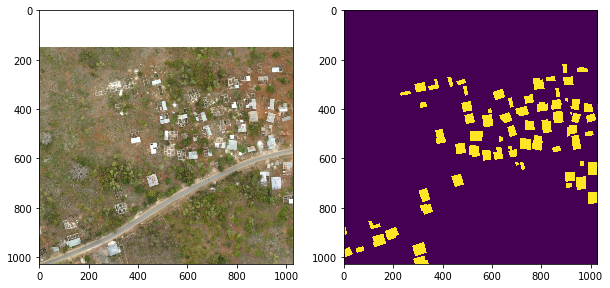

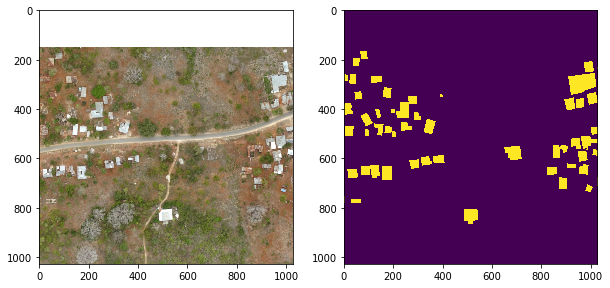




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 33cae6
 iteration 11
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


98it [03:40,  1.02s/it]
98it [00:07, 12.71it/s]


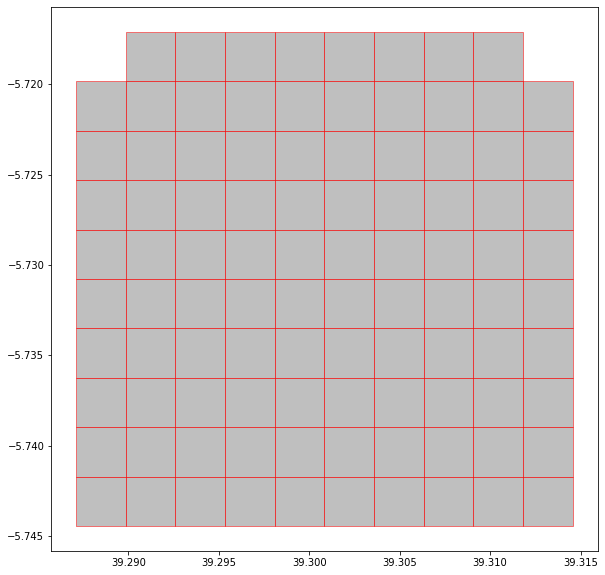

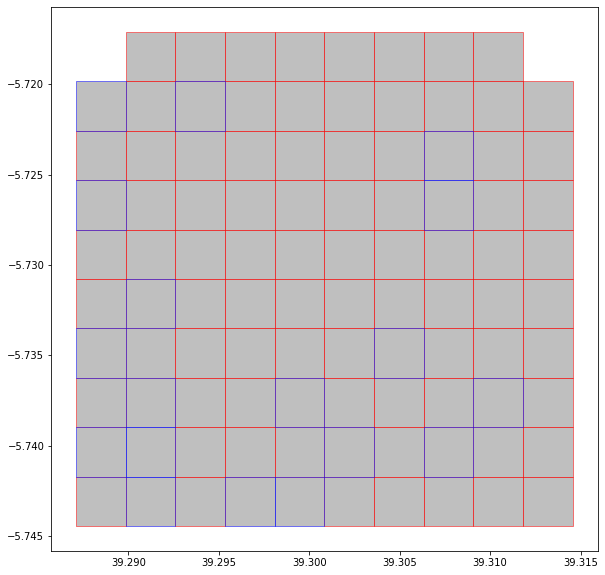

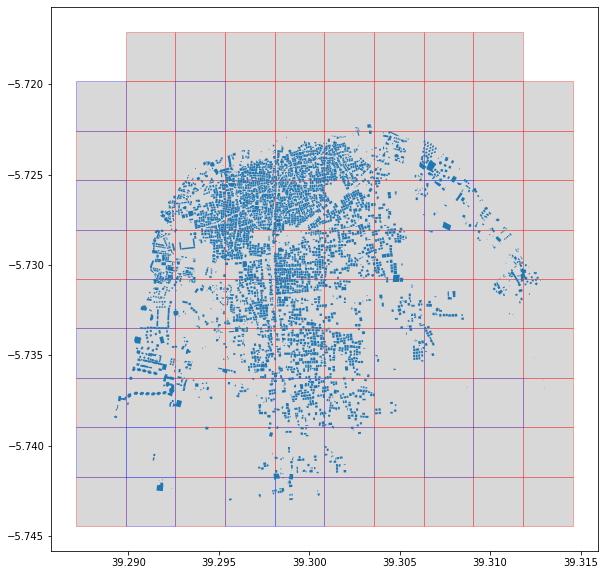

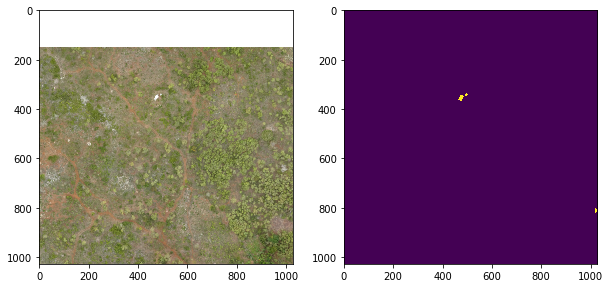

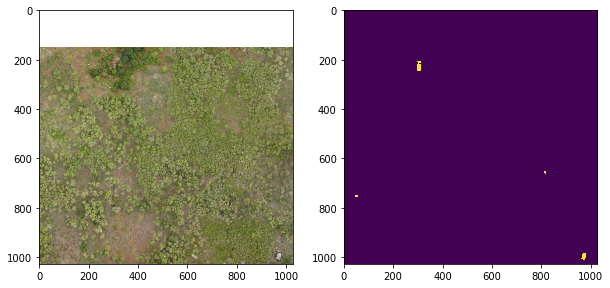

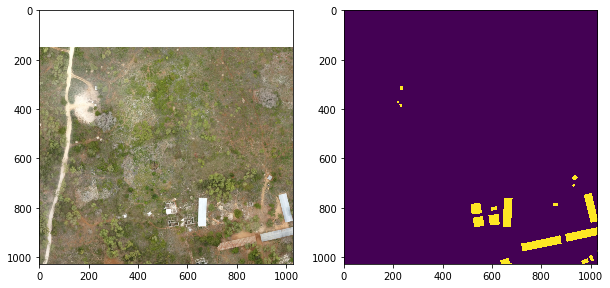

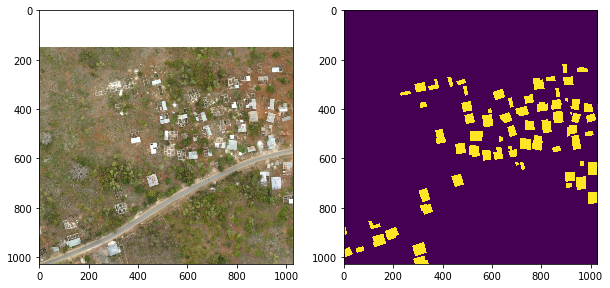

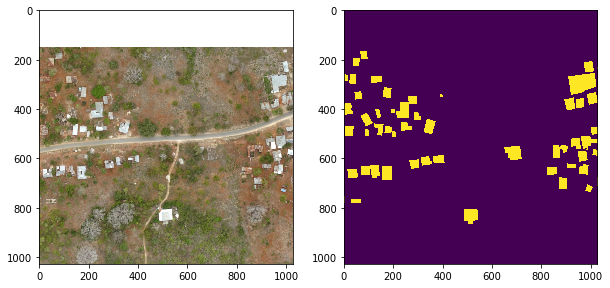




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 425403
 iteration 12
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


110it [04:32,  1.85s/it]
110it [00:02, 39.12it/s]


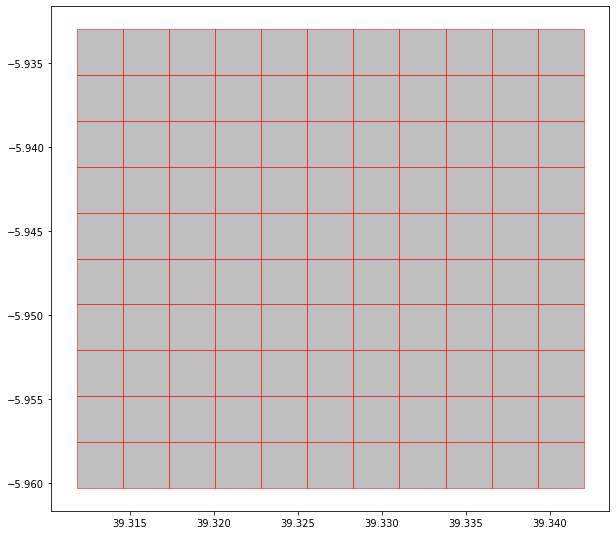

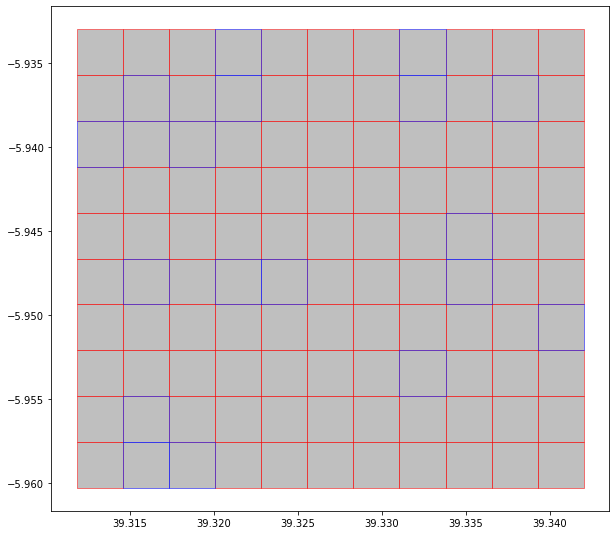

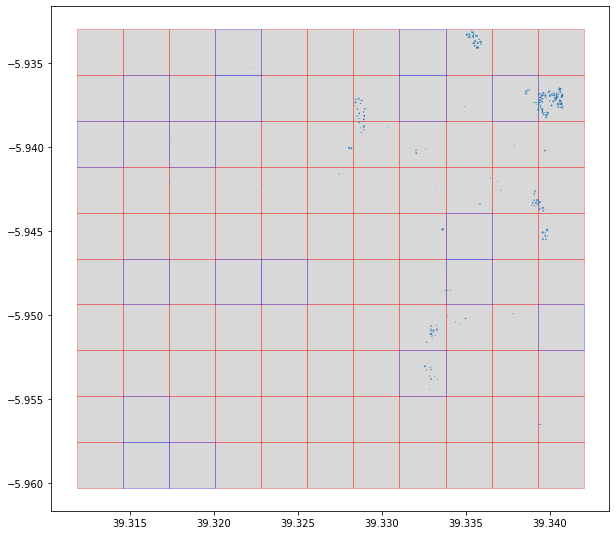

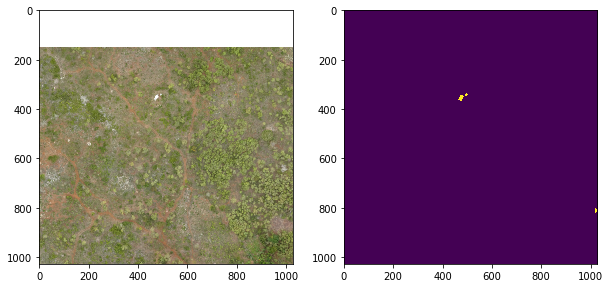

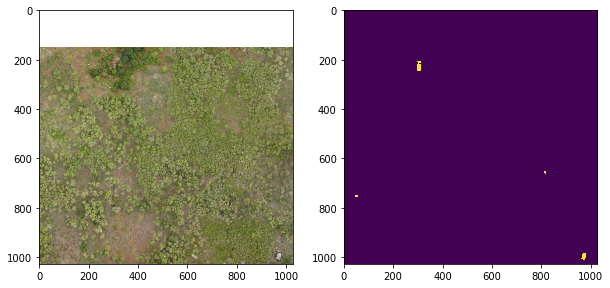

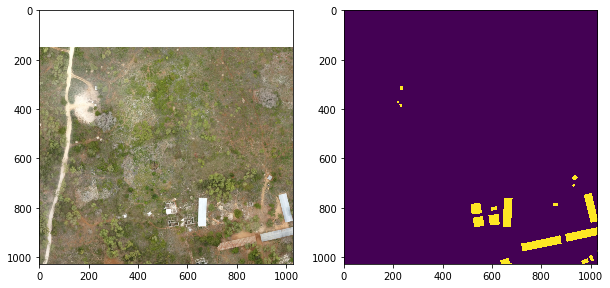

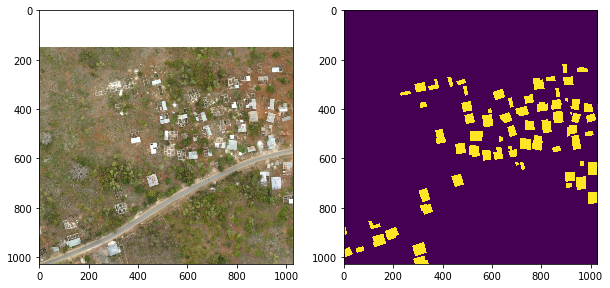

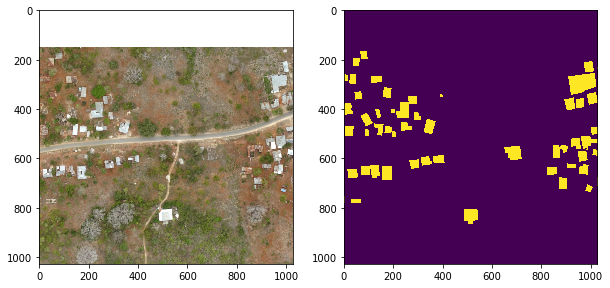




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 9b8638
 iteration 13
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


95it [02:14,  2.02it/s]
95it [00:04, 20.88it/s]


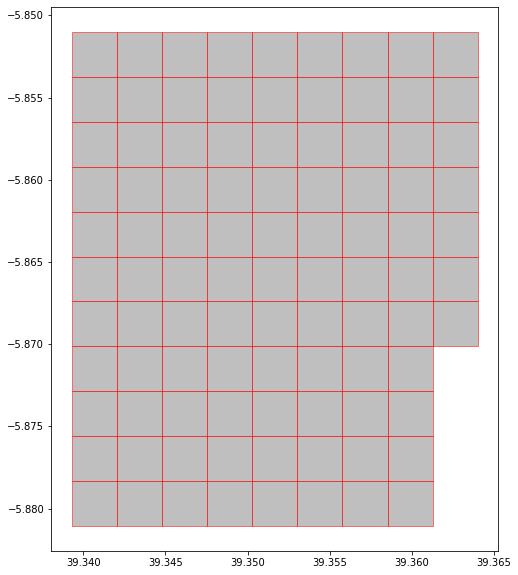

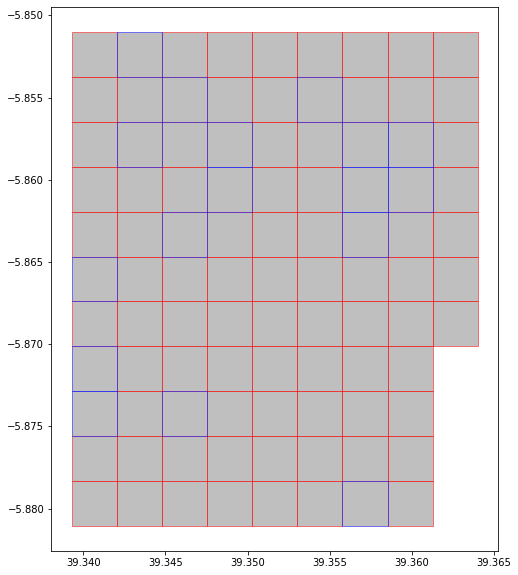

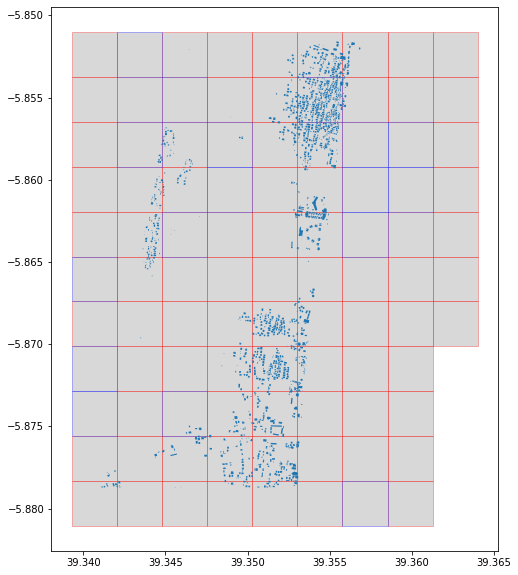

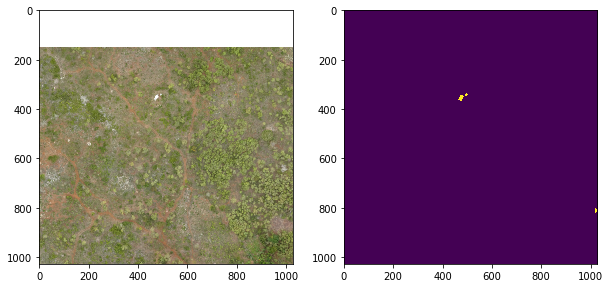

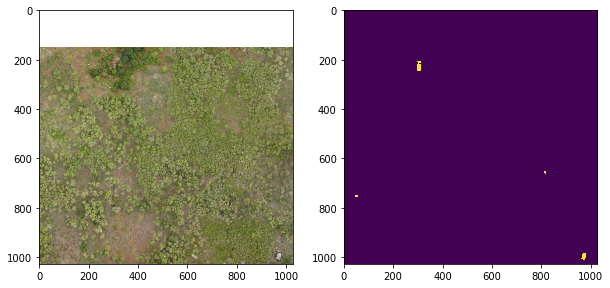

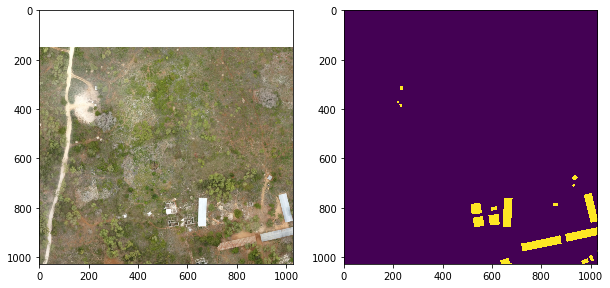

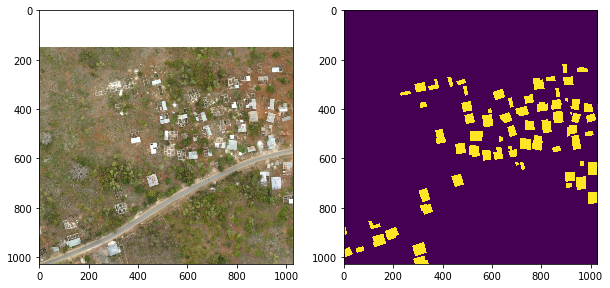

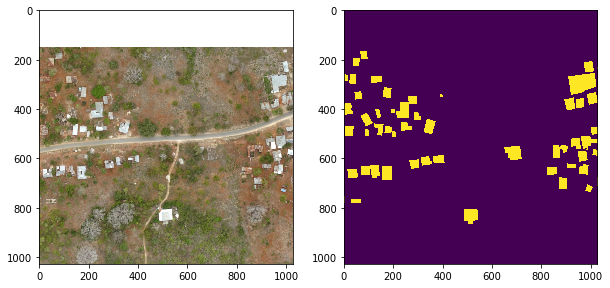

In [55]:
for i in range(len(tif_file_df['tif_file_path'])-27):
  i=i+10
  zoom_level = 17
  image_size = 1028
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, zoom_level=zoom_level, visualize=True)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=True)

  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=1028, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= 1028, region= region,
                          zone= zone, save_path= mask_path_clean, channels=1, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(5,10, df_filepaths)
  


In [0]:
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_1028_17

### Create 461 512x512 tiles at zoom 17




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 kam
 4e7c7f
 iteration 0
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


23it [00:07,  4.12it/s]
23it [00:01, 12.41it/s]


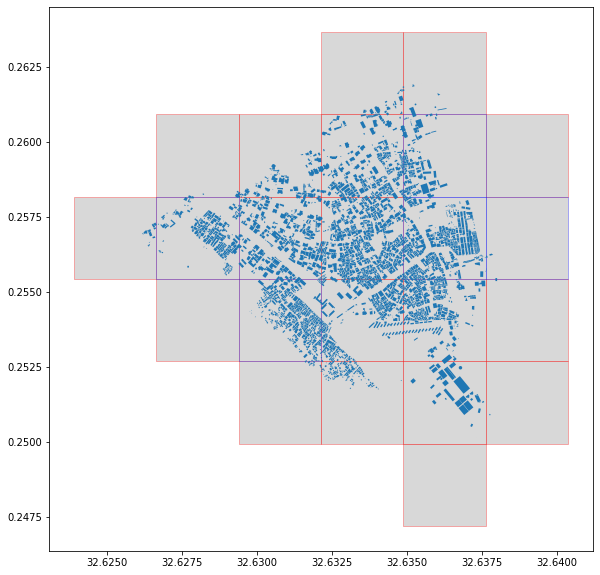

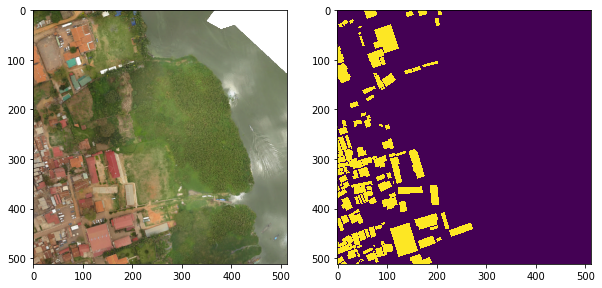

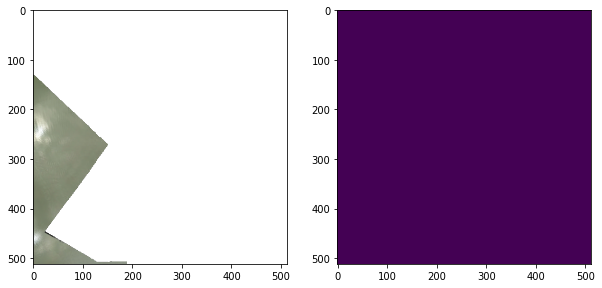

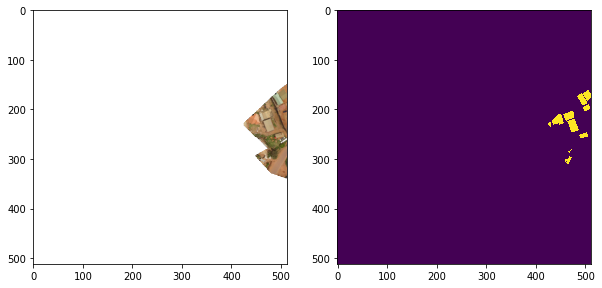

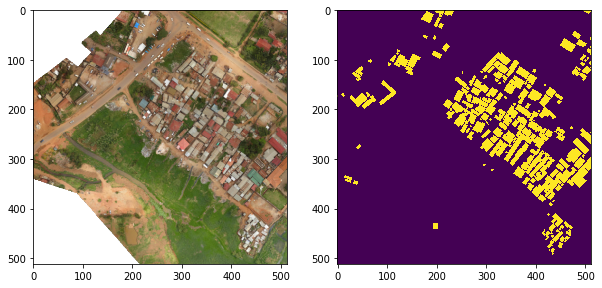

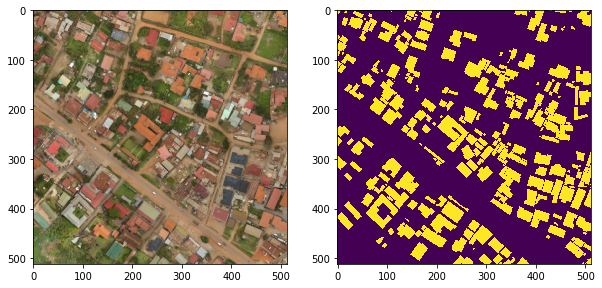




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 42f235
 iteration 1
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


170it [01:12,  4.00it/s]
170it [00:48,  4.23it/s]


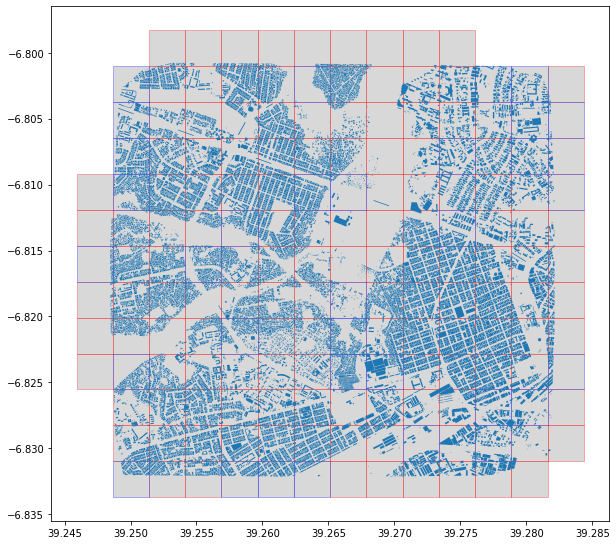

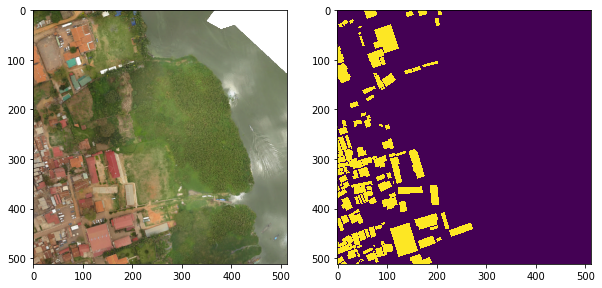

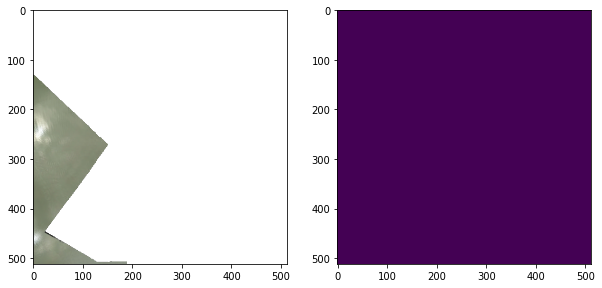

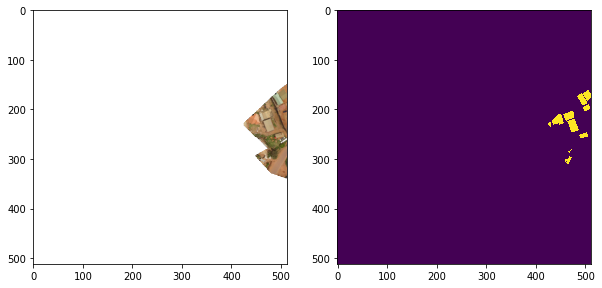

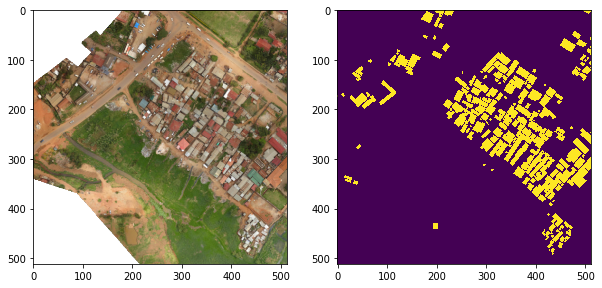

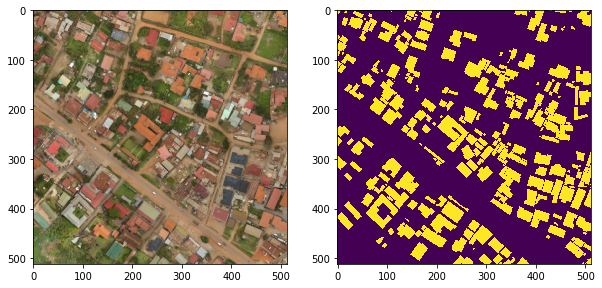




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 f883a0
 iteration 2
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


144it [01:03,  2.28it/s]
144it [00:39,  4.61it/s]


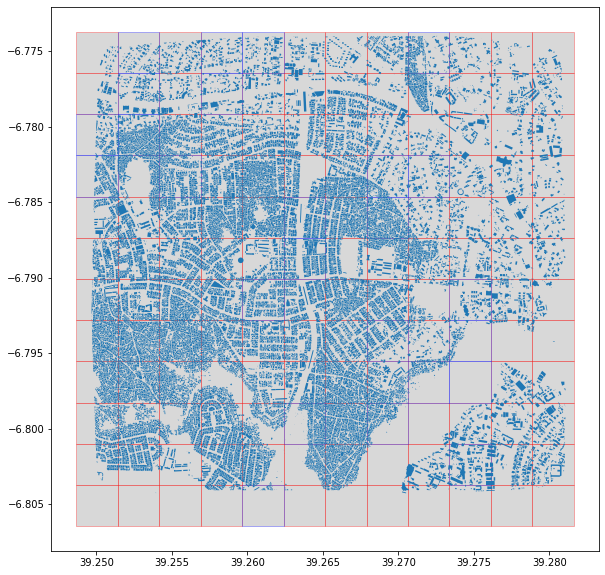

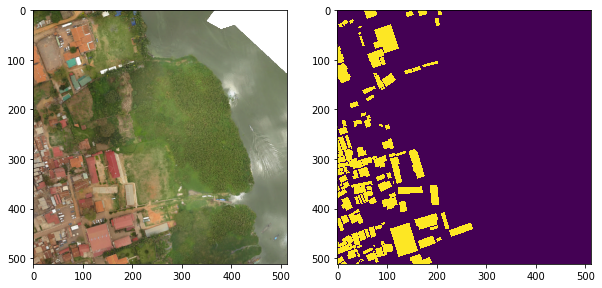

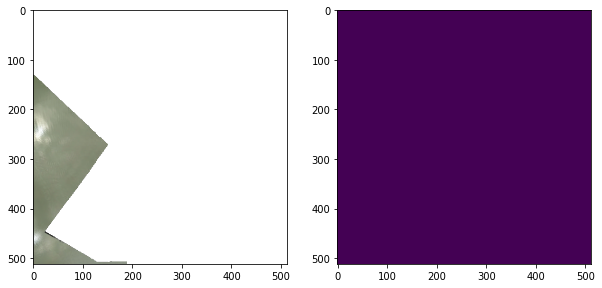

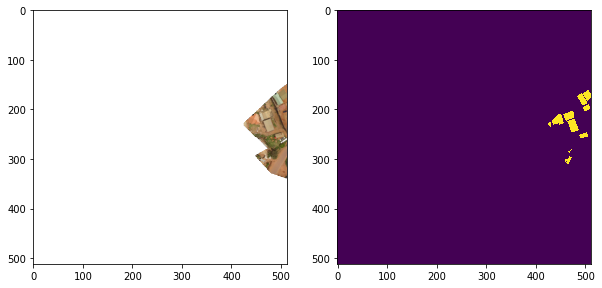

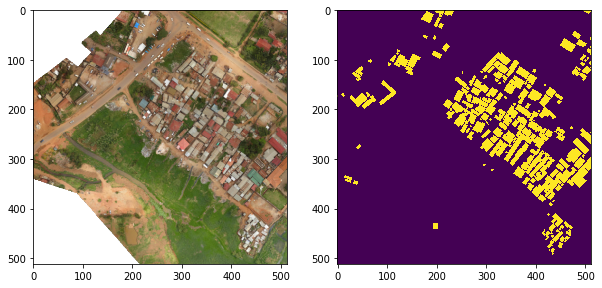

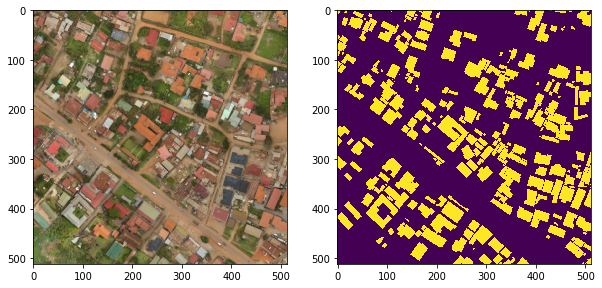




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 0a4c40
 iteration 3
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


124it [01:16,  1.61it/s]
124it [00:11, 10.94it/s]


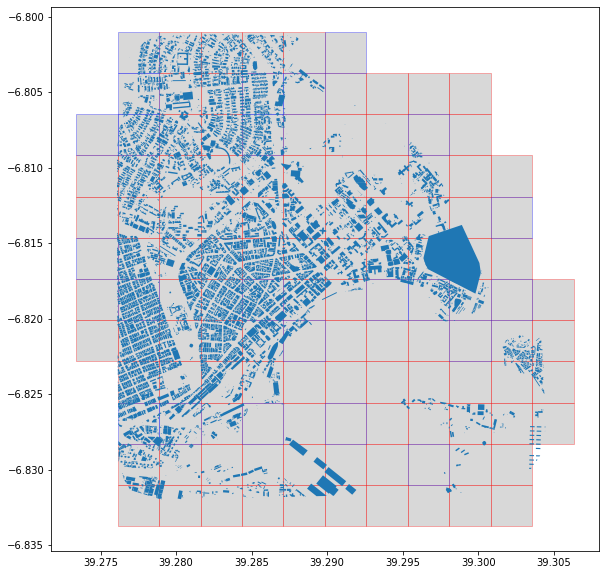

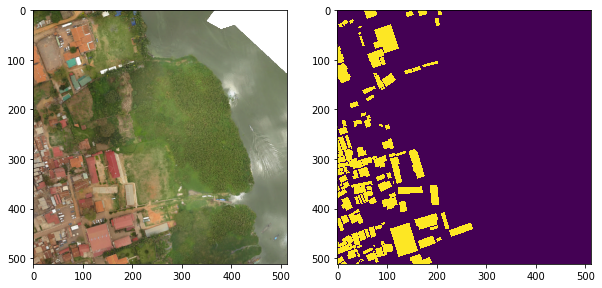

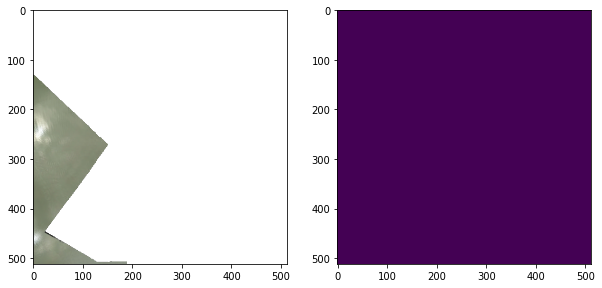

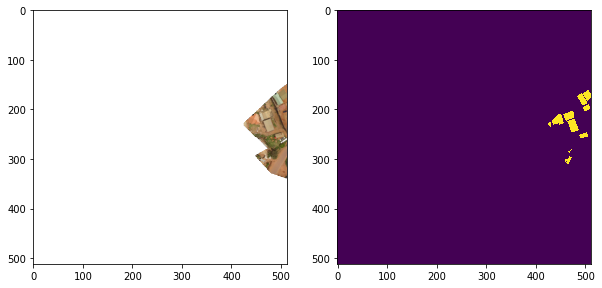

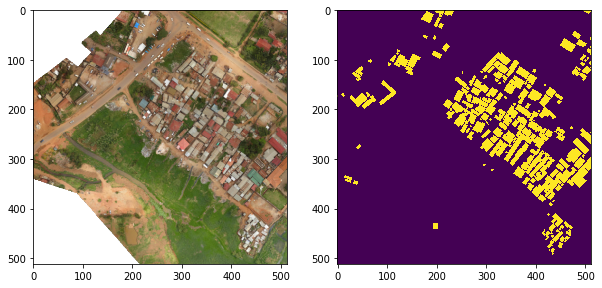

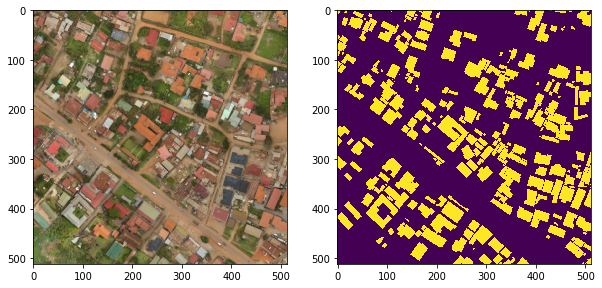

In [57]:
for i in range(len(tif_file_df['tif_file_path'])-27):
  
  zoom_level = 17
  tile_size = 512
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, zoom_level=zoom_level, visualize=False)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=False)

  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=tile_size, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= tile_size, region= region,
                          zone= zone, save_path= mask_path_clean, channels=1, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(5,10, df_filepaths)
  



In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed_1band_512_17
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_512_17

### make 801 256x256 at zoom 18





!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 076995
 iteration 18
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


356it [00:40, 13.81it/s]
356it [00:06, 58.44it/s]


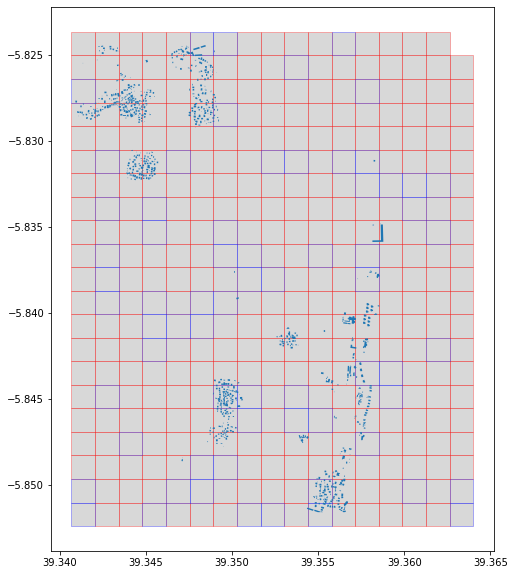

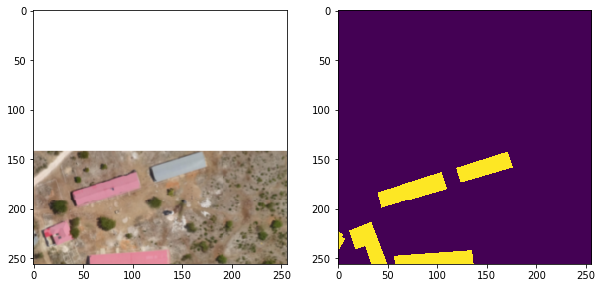

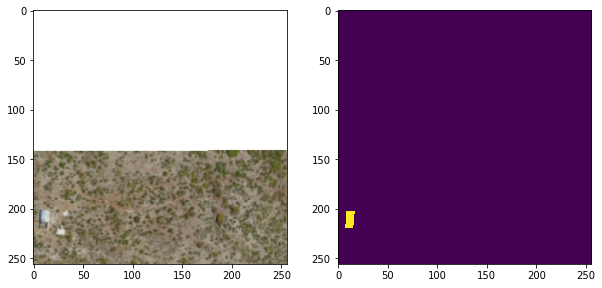

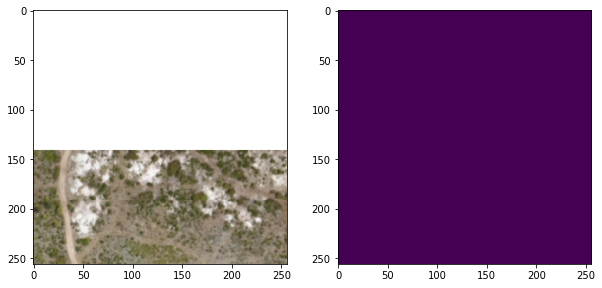

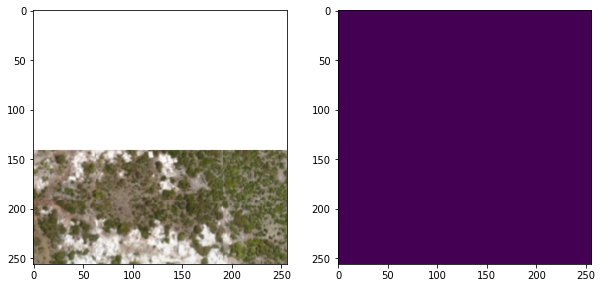

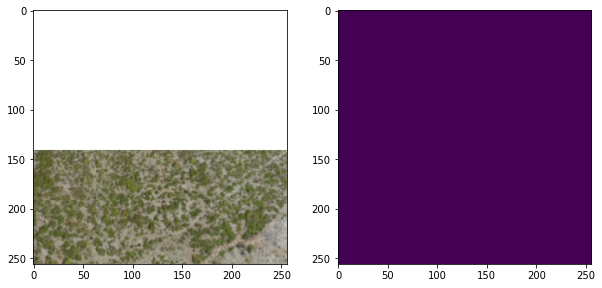




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 e52478
 iteration 19
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


180it [00:29,  6.89it/s]
180it [00:01, 93.72it/s]


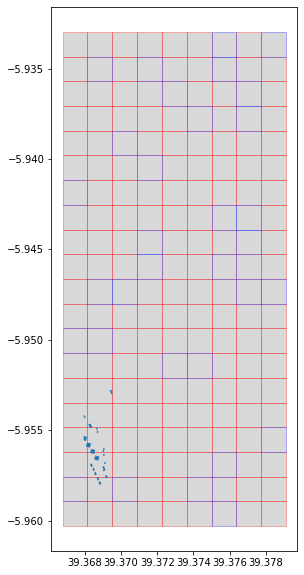

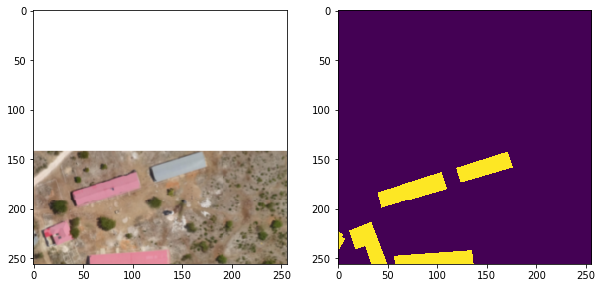

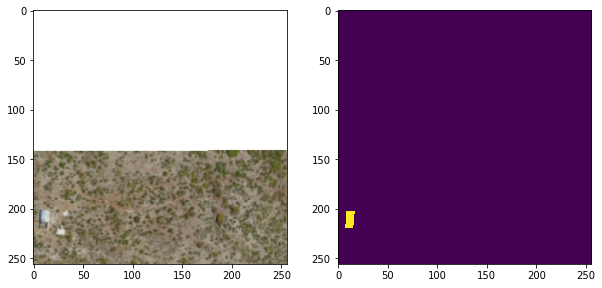

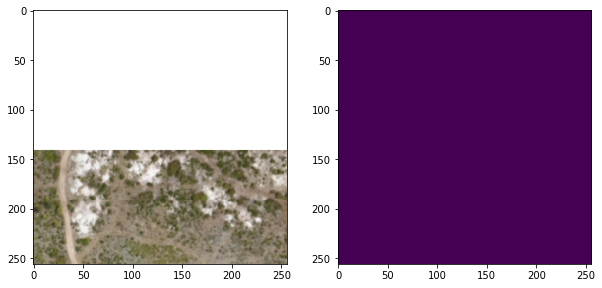

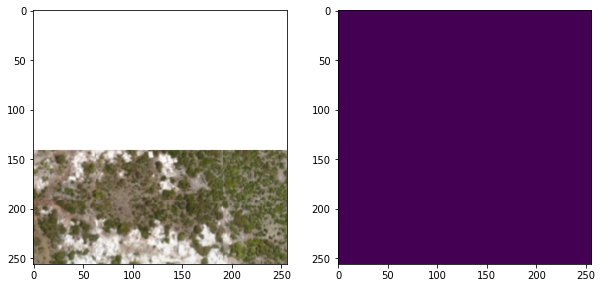

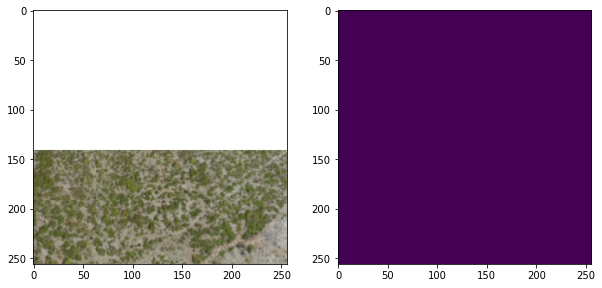




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 665946
 iteration 20
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


132it [00:13,  9.63it/s]
132it [00:09, 14.34it/s]


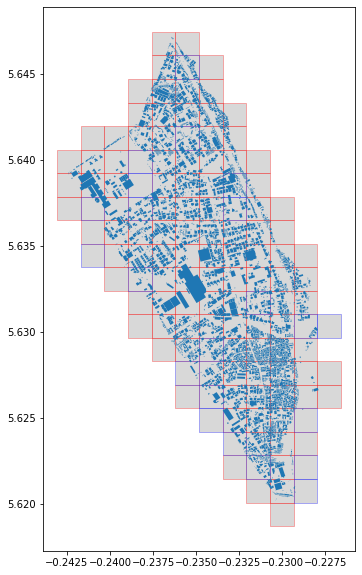

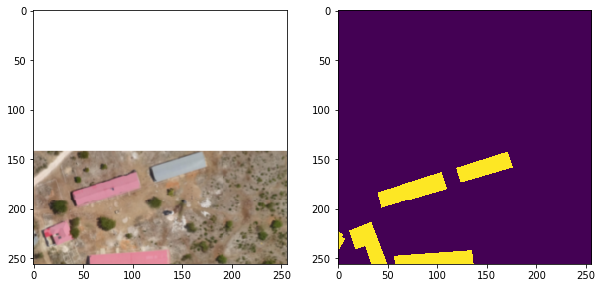

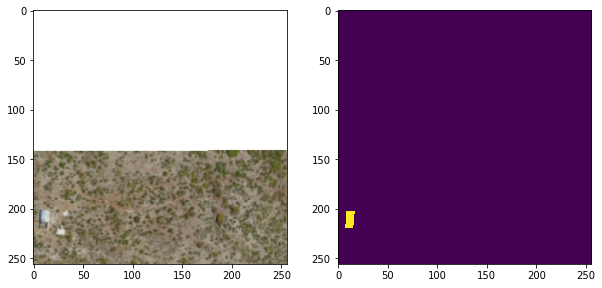

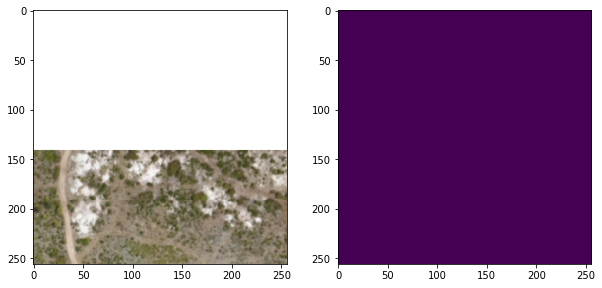

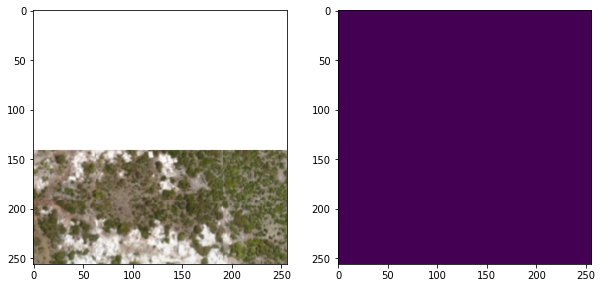

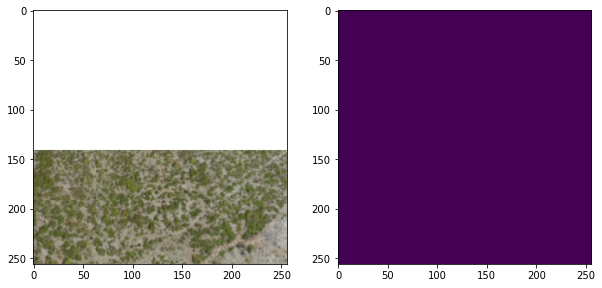




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 ca041a
 iteration 21
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


133it [00:13,  9.97it/s]
133it [00:11, 12.76it/s]


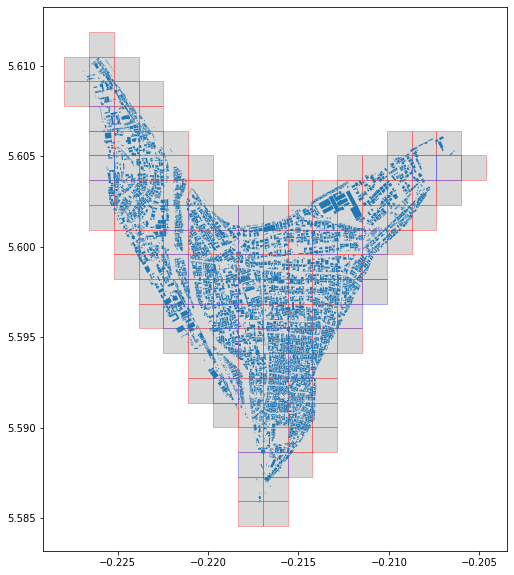

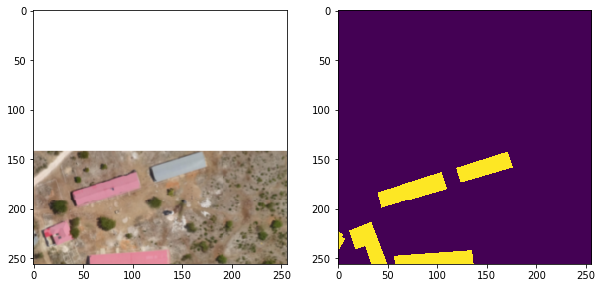

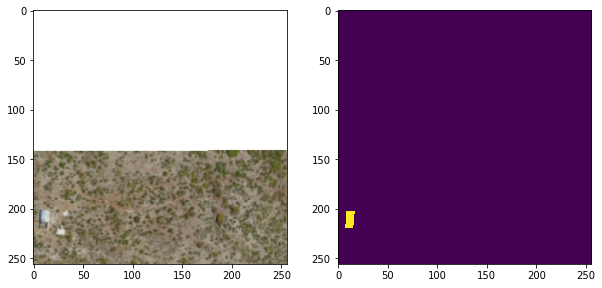

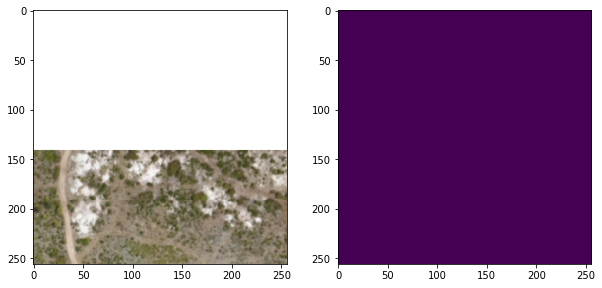

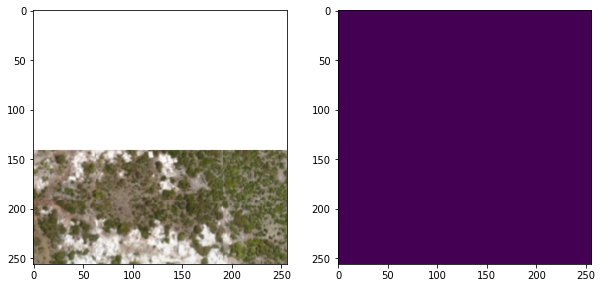

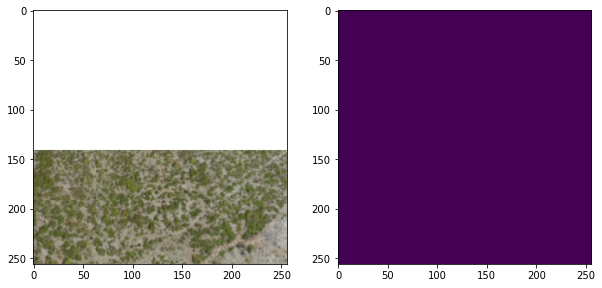

In [64]:
zones = [18,19,20,21]

for i in zones:
  
  zoom_level = 18
  tile_size = 256
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, zoom_level=zoom_level, visualize=False)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=False)

  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=tile_size, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= tile_size, region= region,
                          zone= zone, save_path= mask_path_clean, channels=1, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(5,10, df_filepaths)
  



In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed_1band_256_18
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_256_18




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 d41d81
 iteration 22
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


428it [00:19, 21.58it/s]
428it [00:30, 15.14it/s]


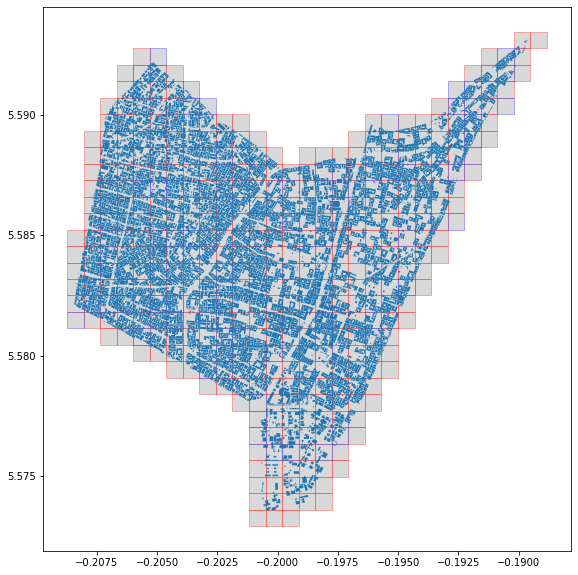

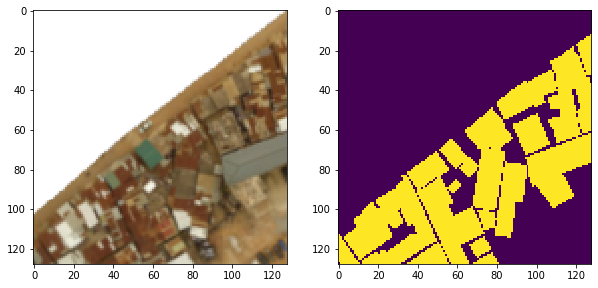

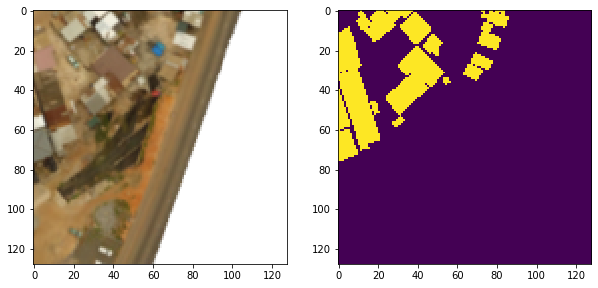

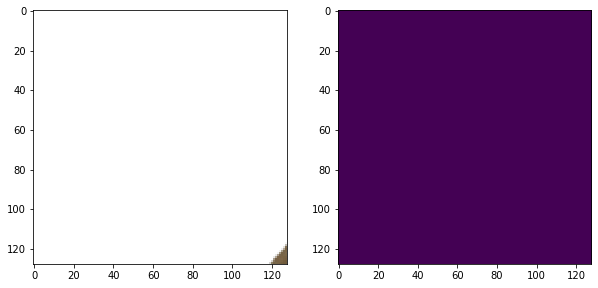

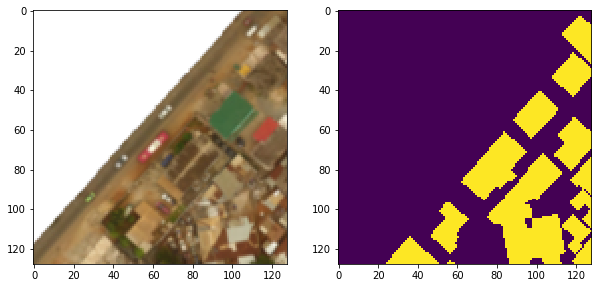

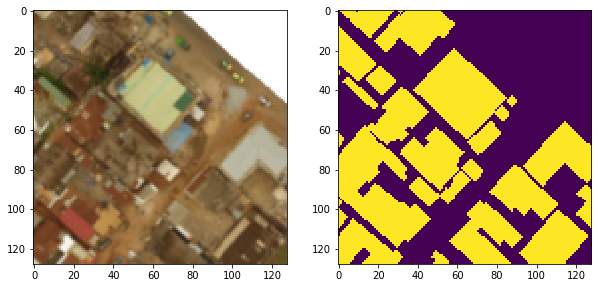




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 a42435
 iteration 23
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


291it [00:12, 28.14it/s]
291it [00:16, 20.10it/s]


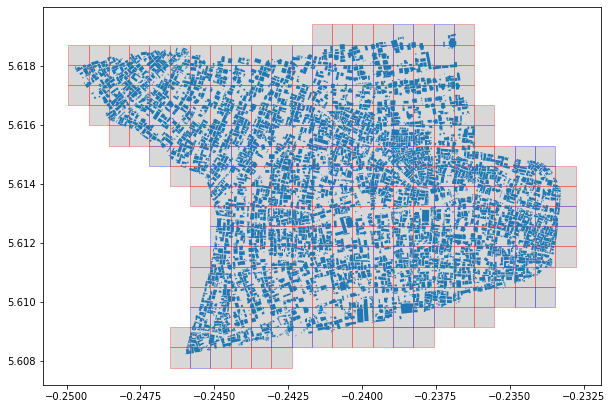

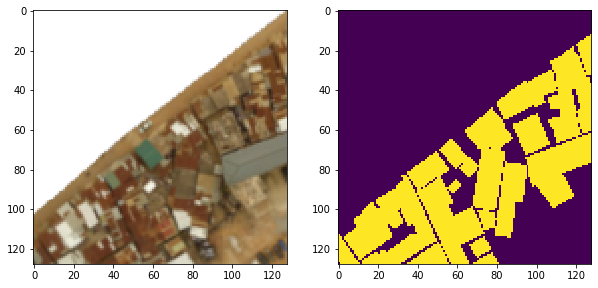

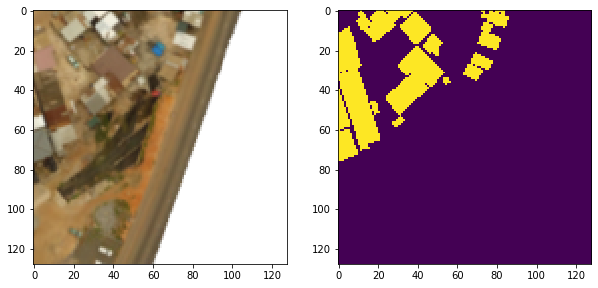

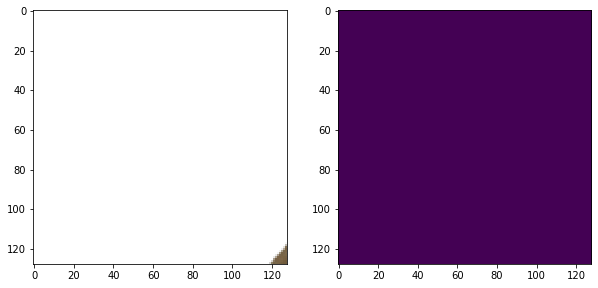

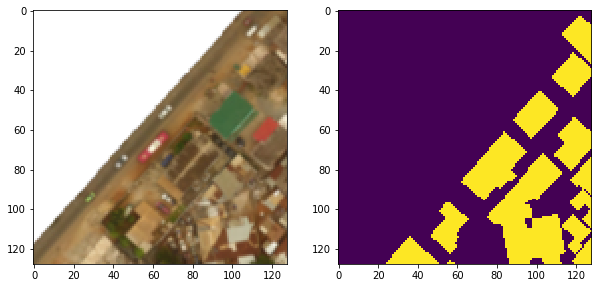

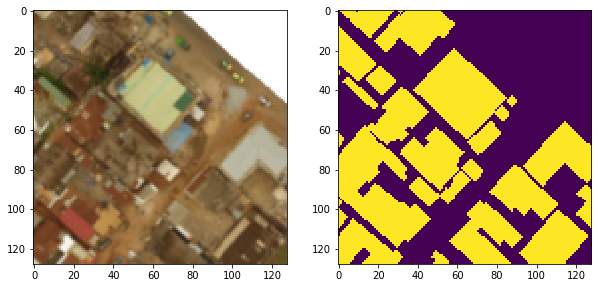




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 ptn
 abe1a3
 iteration 24
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


276it [00:12, 21.99it/s]
276it [00:14, 19.46it/s]


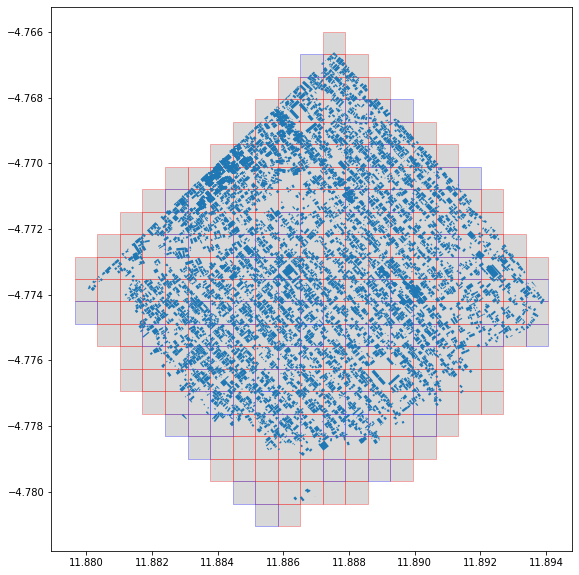

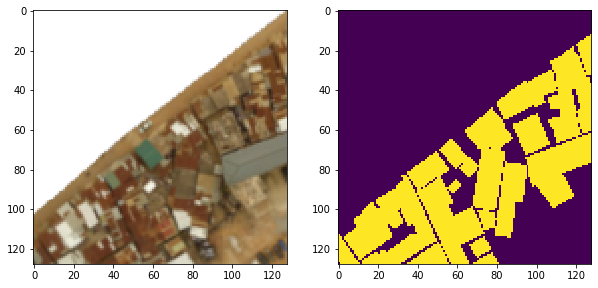

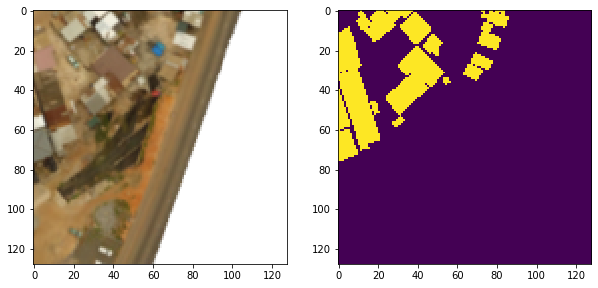

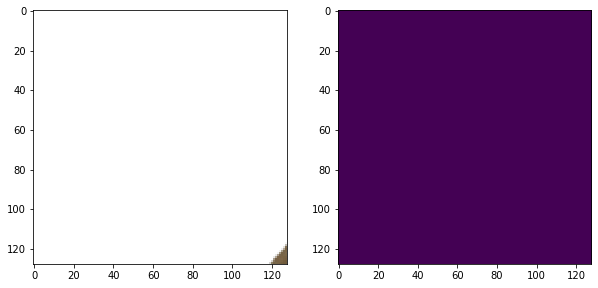

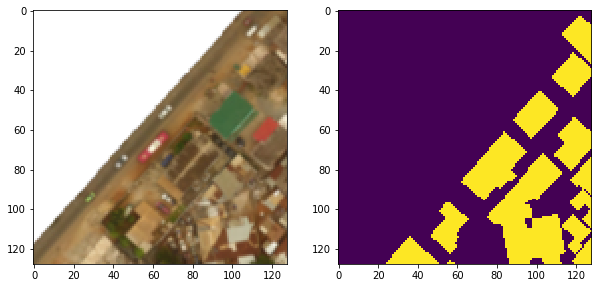

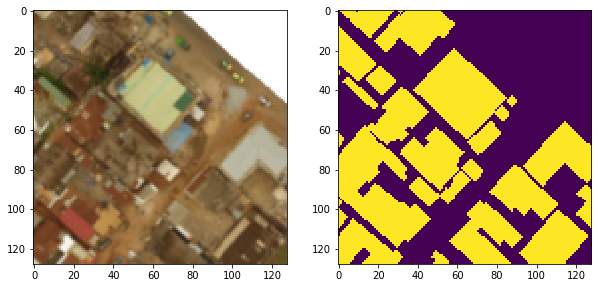




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 ptn
 f49f31
 iteration 25
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


124it [00:05, 22.39it/s]
124it [00:04, 28.68it/s]


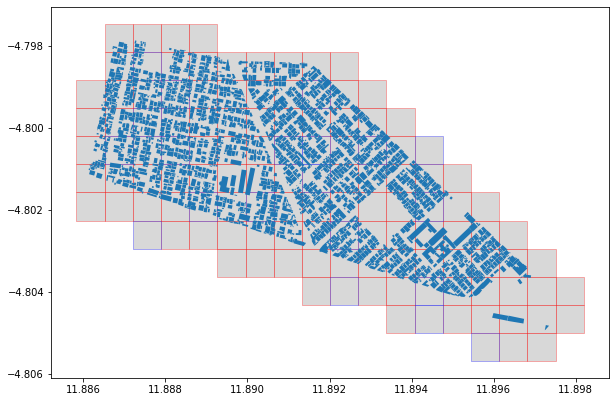

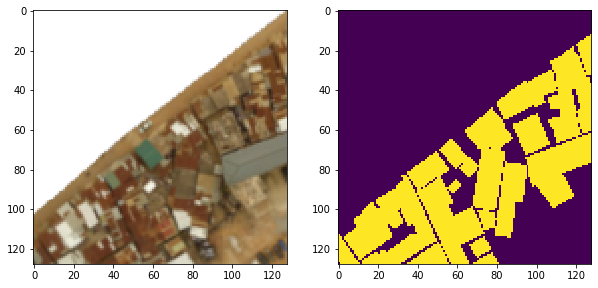

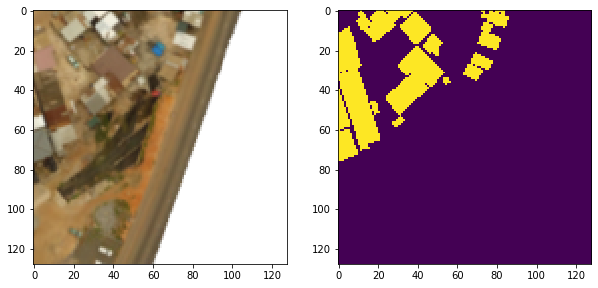

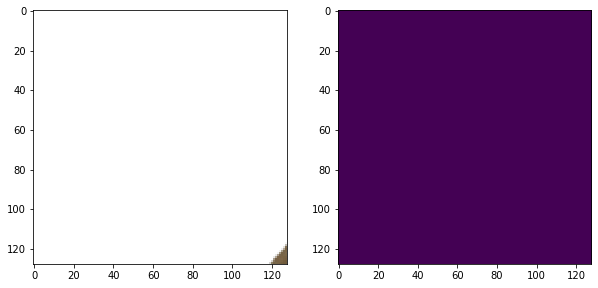

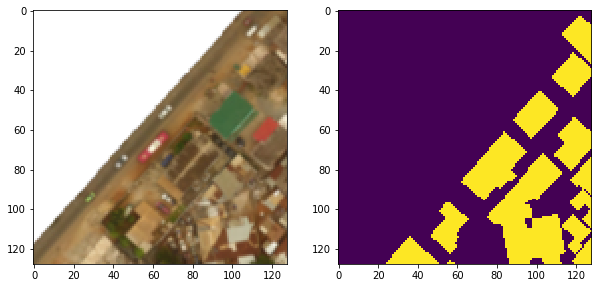

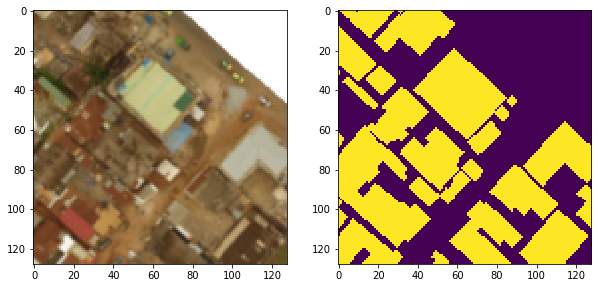

In [66]:
zones = [22,23,24,25]

for i in zones:
  
  zoom_level = 19
  tile_size = 128
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, zoom_level=zoom_level, visualize=False)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=False)

  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=tile_size, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= tile_size, region= region,
                          zone= zone, save_path= mask_path_clean, channels=1, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(5,10, df_filepaths)
  



In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed_1band_128_19
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_128_19




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 mon
 f15272
 iteration 26
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


86it [03:00,  1.31it/s]
86it [00:08,  9.66it/s]


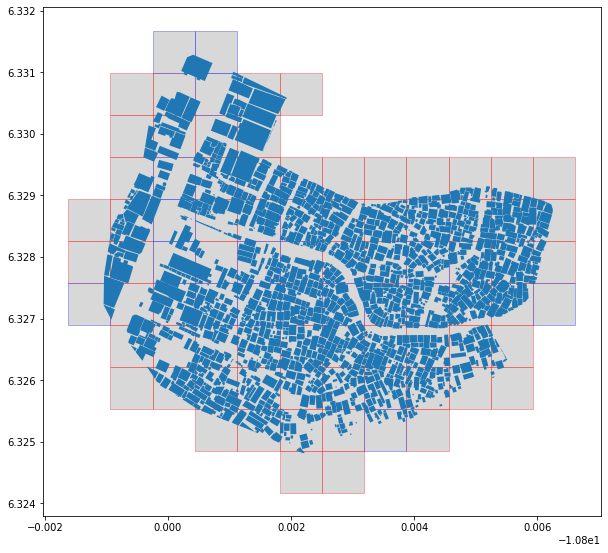

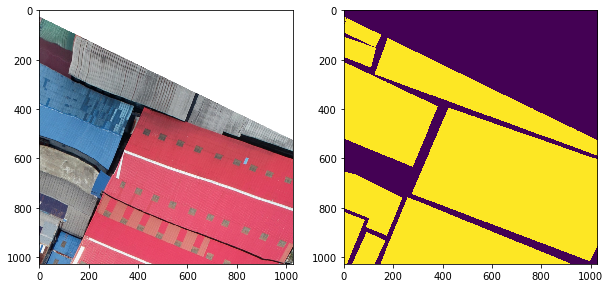

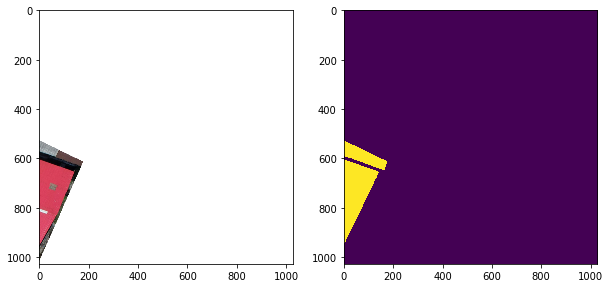

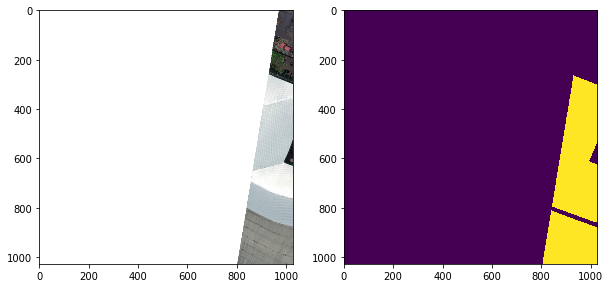

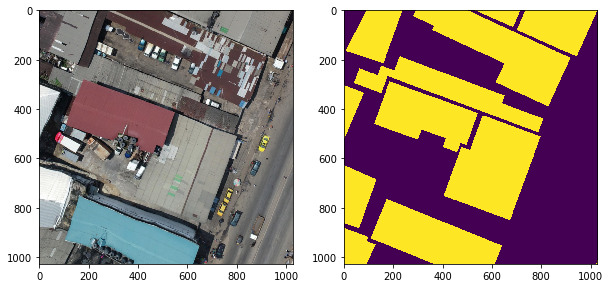

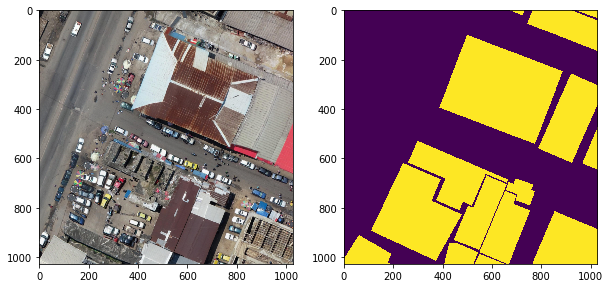




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 mon
 207cc7
 iteration 27
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


99it [03:07,  1.01it/s]
99it [00:08, 11.28it/s]


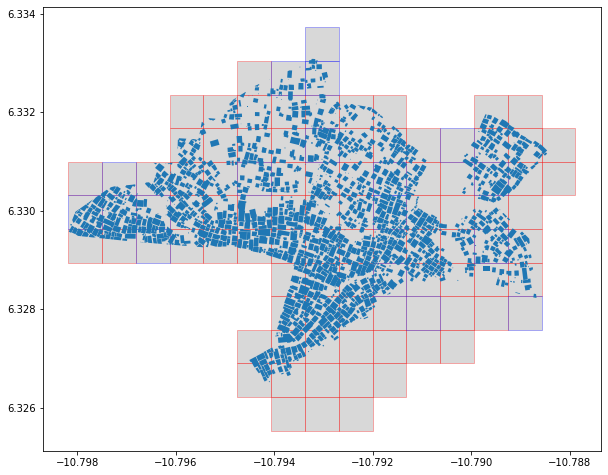

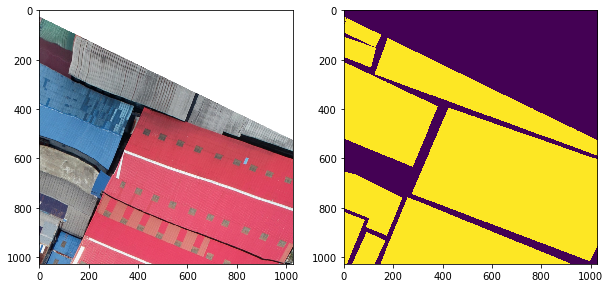

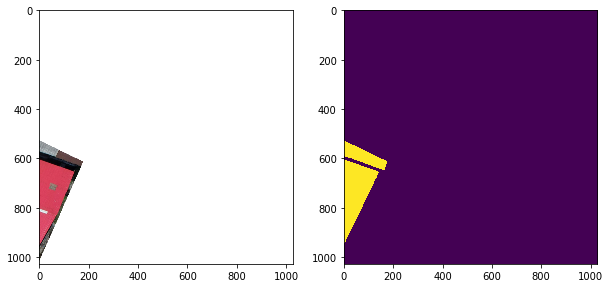

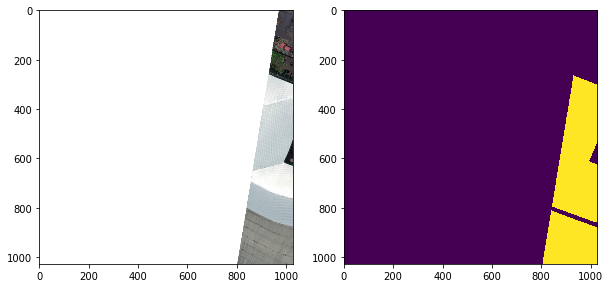

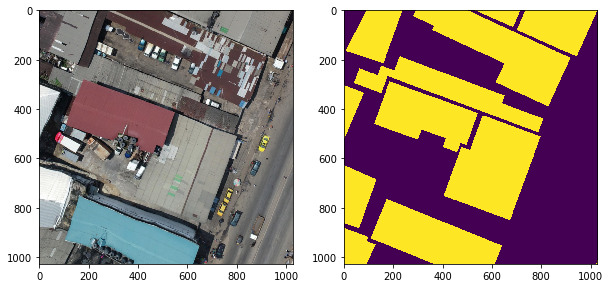

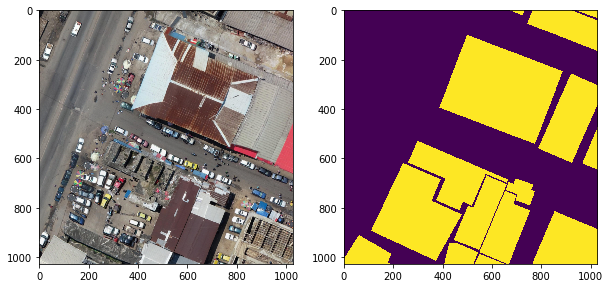

In [68]:
zones = [26,27]

for i in zones:
  
  zoom_level = 19
  tile_size = 1028
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, zoom_level=zoom_level, visualize=False)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=False)

  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=tile_size, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= tile_size, region= region,
                          zone= zone, save_path= mask_path_clean, channels=1, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(5,10, df_filepaths)
  



In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed_1band_1028_19
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_1028_19




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 kam
 4e7c7f
 iteration 0
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


8it [00:28,  3.49s/it]
8it [00:02,  3.24it/s]


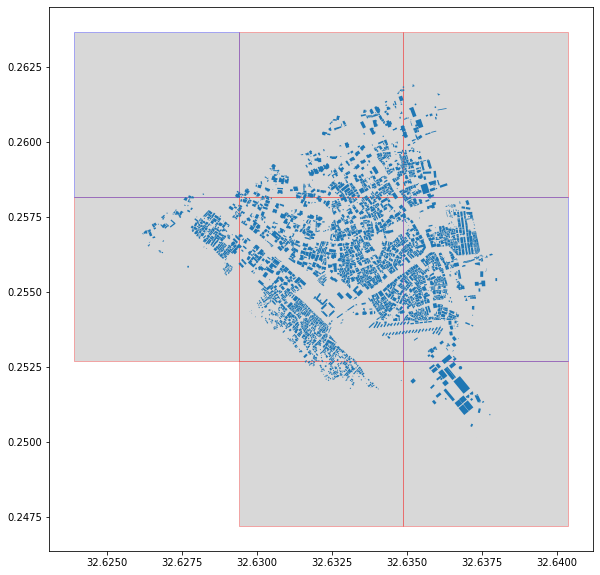

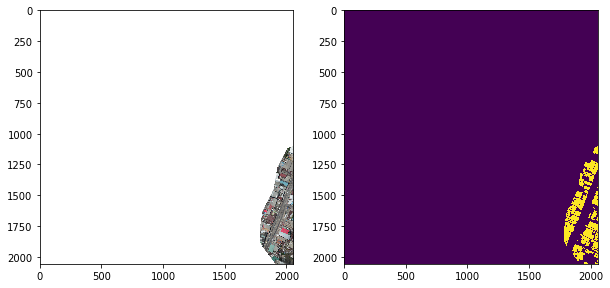

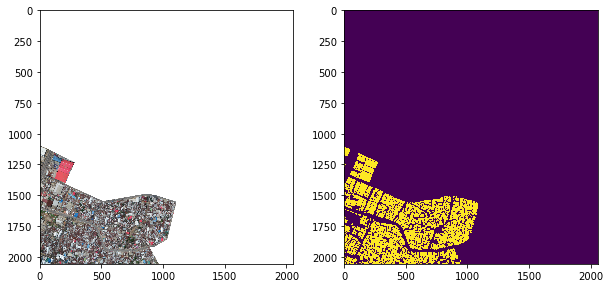




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 42f235
 iteration 1
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


51it [05:43,  5.51s/it]
51it [00:34,  2.07it/s]


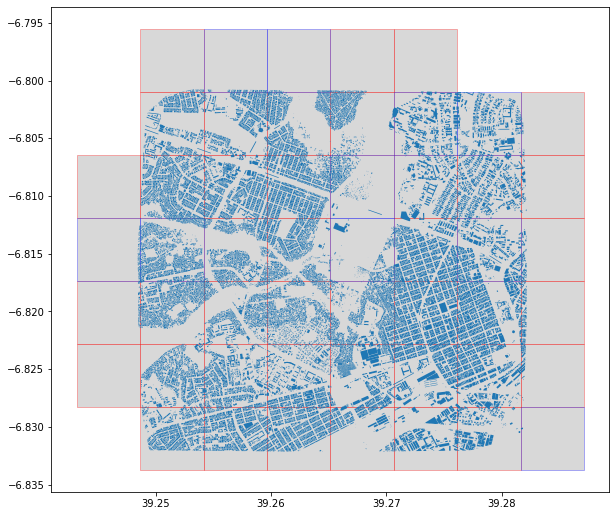

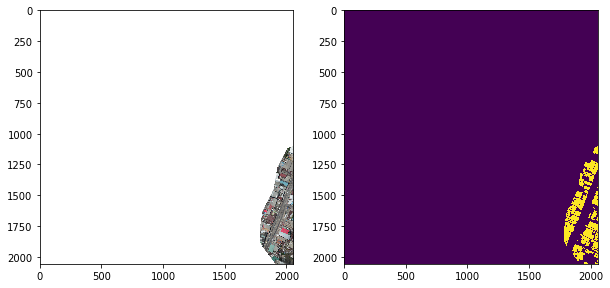

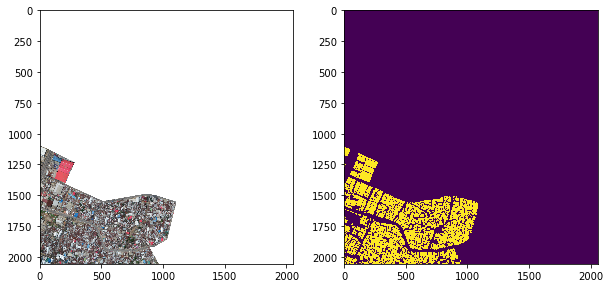




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 f883a0
 iteration 2
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!


KeyboardInterrupt: ignored

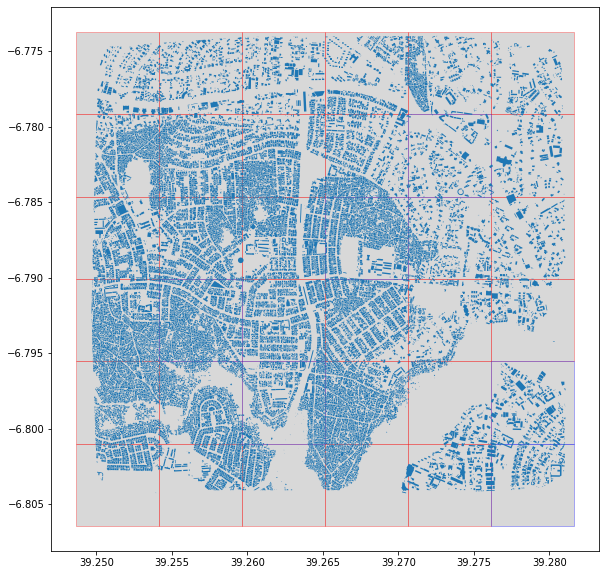

In [73]:


for i in range(len(tif_file_df['tif_file_path'])):  
  zoom_level = 16
  tile_size = 2056
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, zoom_level=zoom_level, visualize=False)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=False)

  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=tile_size, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= tile_size, region= region,
                          zone= zone, save_path= mask_path_clean, channels=1, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(0,2, df_filepaths)
  



In [0]:
!mkdir drive/My\ Drive/seg_building_foots/data/processed_1band_2056_16
!mv drive/My\ Drive/seg_building_foots/data/processed/* drive/My\ Drive/seg_building_foots/data/processed_1band_2056_16